**Tabla de contenido**
- [Introducción](#Introducción)
- [Lib](#Lib)
- [Lectura de datos](#Lectura-de-datos)
- [Limpieza de datos](#Limpieza-de-datos)
    - [Weekly Sales](#Weekly-Sales)

- [Series limpias](#Series-limpias)
- [Porcentaje eliminado](#Porcentaje-eliminado)
- [Conclusiones](#Conclusiones)

# Introducción

En este cuaderno, Limpieza de Datos de Ventas para Análisis y Predicción de Ventas (LDV-APV), se llevará a cabo la limpieza y preparación de las series de tiempo. El objetivo es garantizar la calidad y precisión de los datos, lo que es fundamental para la exploración de datos y el entrenamiento de modelos de machine learning. Sin esta etapa crucial, es probable que los modelos no logren resultados óptimos ni precisos.

# Lib

Para garantizar el correcto funcionamiento de este cuaderno, se requieren las siguientes librerías:

- **Python:** Versión 3.12.3
- **Pandas:** Versión 2.2.3
- **Matplotlib:** Versión 3.10.0

In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams

# Lectura de datos

Los datos se leyeron desde un archivo CSV exportado desde la tabla Walmart_Sales de la base de datos TFM en SQL Server 2022. El archivo CSV utiliza el carácter ";" como delimitador.

**Para leer correctamente este archivo, es necesario proporcionar la ruta donde se encuentra almacenado.**

In [2]:
os.chdir('D:\\6. NEXER\\master\\Solucion TFM\\2. Datos en CSV')
WalmartSales = pd.read_csv('TFM_Table_Walmart_Sales.csv', delimiter=';')
WalmartSales.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Holiday_Events
0,1,05-02-2010,16436909,0,42.31,2.572,211.096358,8.106,No aplica
1,1,12-02-2010,164195744,1,38.51,2.548,211.242176,8.106,Super Bowl
2,1,19-02-2010,161196816,0,39.93,2.514,211.289139,8.106,No aplica
3,1,26-02-2010,140972752,0,46.63,2.561,211.319642,8.106,No aplica
4,1,05-03-2010,155480672,0,46.50,2.625,211.350144,8.106,No aplica


# Limpieza de datos

Antes de realizar la limpieza de datos, codifiquemos la variable Holiday_Events, asignando el valor 1 a los días festivos y 0 a los días no festivos. Además, configuremos la fecha como índice.

In [3]:
WalmartSales['Holiday_Events'] = WalmartSales['Holiday_Events'].map({
    'No aplica':0,
    'Super Bowl':1,
    'Labour Day':1,
    'Thanksgiving':1,
    'Christmas':1})
WalmartSales['Date'] = pd.to_datetime(WalmartSales['Date'],format = '%d-%m-%Y')
WalmartSales= WalmartSales.set_index(WalmartSales['Date'])
WalmartSales = WalmartSales.drop('Date', axis=1)
WalmartSales.head(3)

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Holiday_Events
Date,,,,,,,,
2010-02-05,1,16436909,0,42.31,2.572,211.096358,8.106,0
2010-02-12,1,164195744,1,38.51,2.548,211.242176,8.106,1
2010-02-19,1,161196816,0,39.93,2.514,211.289139,8.106,0


Ahora sí, veamos cómo se comportan los valores atípicos.

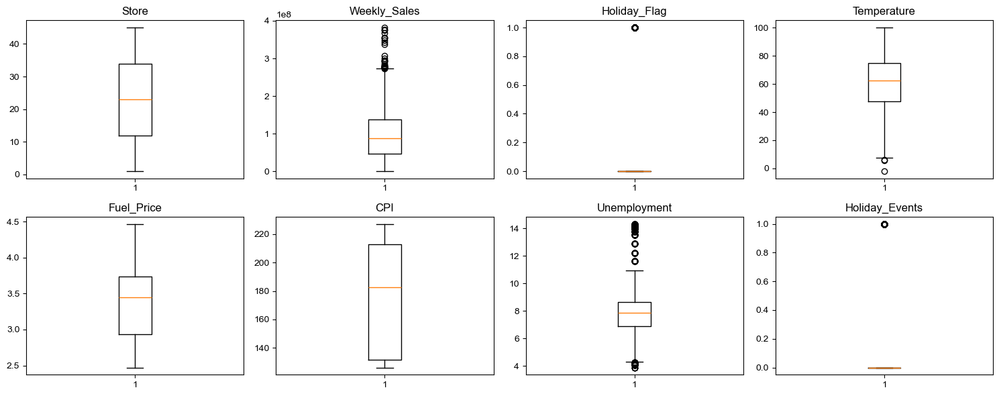

In [4]:
df = WalmartSales.copy()
rcParams['font.family'] = 'Arial'
fig, axs = plt.subplots(2, 4, figsize=(15, 6))
for i, col in enumerate(df.columns):
    axs[i // 4, i % 4].boxplot(df[col])
    axs[i // 4, i % 4].set_title(col)
plt.tight_layout()

Podemos observar que las variables con valores atípicos son Weekly_Sales, Temperature y Unemployment. Además, parece que las variables Holiday_flag y Holiday_Events son equivalentes. Por ahora, analicemos para una tienda las series de las variables que presentan valores atípicos.

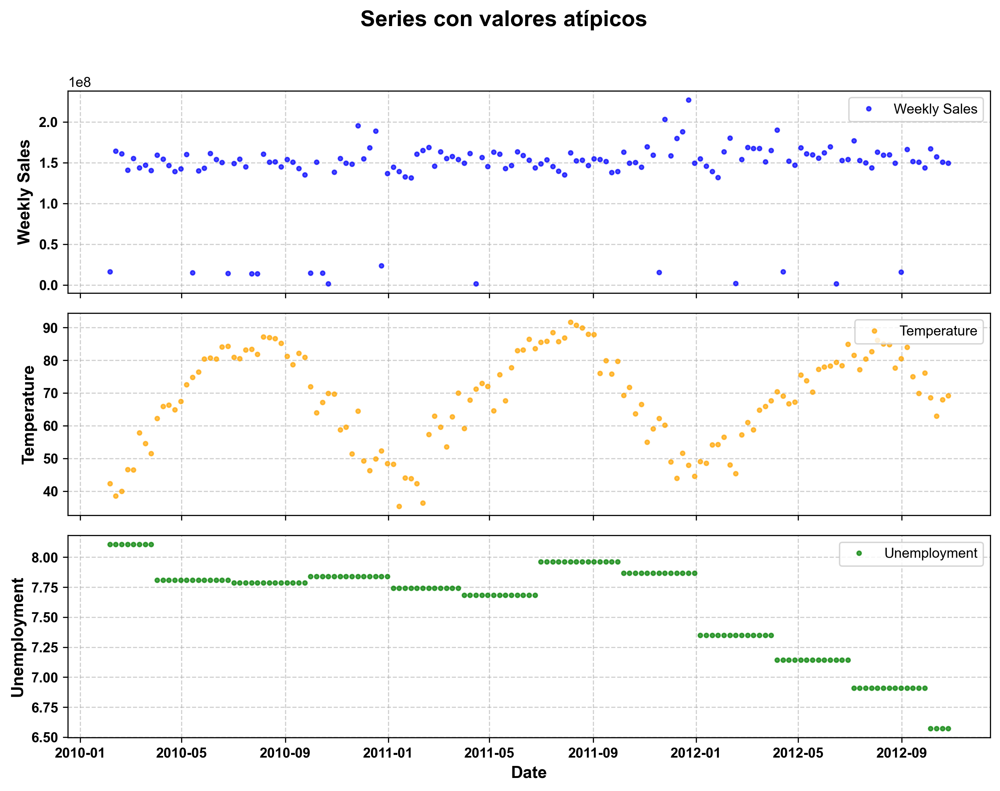

In [5]:
data = df[df['Store']==1]
fig, axs = plt.subplots(3, figsize=(10, 8), sharex=True,dpi=300)
fig.suptitle('Series con valores atípicos', fontsize=16, fontweight='bold')

# Datos de las series
series = ['Weekly_Sales', 'Temperature', 'Unemployment']
labels = [s.replace('_', ' ').title() for s in series]
colors = ['blue', 'orange', 'green']

# Graficar cada serie
for i, ax in enumerate(axs):
    ax.plot(data[series[i]], '.', label=labels[i], color=colors[i], alpha=0.7)
    ax.set_ylabel(labels[i], fontsize=12, fontweight='bold')
    ax.legend(loc='upper right', fontsize=10)
    ax.grid(visible=True, linestyle='--', alpha=0.6)
    
    # Personalizar el eje Y
    ax.tick_params(axis='y', labelsize=10)
    ax.yaxis.set_tick_params(labelsize=10)
    for tick in ax.get_yticklabels():
        tick.set_fontweight('bold')

# Personalizar el eje X para las fechas
axs[-1].set_xlabel('Date', fontsize=12, fontweight='bold')
axs[-1].tick_params(axis='x', labelsize=10)
for tick in axs[-1].get_xticklabels():
    tick.set_fontweight('bold')
plt.tight_layout(rect=[0, 0, 1, 0.96])
del data

Podemos observar que la serie con mayor ruido es la de ventas semanales. Nos centraremos en limpiar únicamente esta serie.

## Weekly Sales

Vamos a crear una función que nos permita identificar los valores atípicos en la serie de tiempo. Esta función realiza los siguientes cálculos:

- Calcula una media móvil con un paso de 3.
- A partir de la media móvil, calcula el incremento porcentual de los datos, es decir, en cada instante de tiempo, mide cuánto ha cambiado la serie en relación con la media móvil.
- Determina los valores extremos basándose en el incremento porcentual.
- Marca en rojo sobre la serie los valores considerados atípicos.
- Genera un diagrama de cajas para visualizar los valores extremos.

La función recibe como entrada un DataFrame, la cantidad de pasos para la media móvil (window) y un porcentaje. Este porcentaje se determina mediante el análisis del diagrama de cajas y bigotes de la variable cambio porcentual, y se utiliza para identificar y graficar los valores atípicos.

In [22]:
def STS(df, store, window, porcentaje):
    data = df[df['Store'] == store]
    data = data.copy()
    fig, axs = plt.subplots(3, sharex=False, figsize=(10, 8), gridspec_kw={'height_ratios': [3, 3, 1]},dpi=300)
    fig.suptitle('Series', fontsize=16, fontweight='bold')

    # Graficar ventas semanales y media móvil
    axs[0].plot(data['Weekly_Sales'], '.', label='Ventas semanales', color='blue')
    axs[0].set_ylabel('Weekly_Sales'.replace('_', ' ').title(), fontsize=12, fontweight='bold')
    data.loc[:, 'media_movil'] = data['Weekly_Sales'].rolling(window=window).mean()
    axs[0].plot(data['media_movil'], label='Media móvil', color='orange')
    axs[0].legend(loc='upper right', fontsize=10)
    axs[0].grid(True, linestyle='--', alpha=0.6)

    # Personalización de las etiquetas de los ejes Y
    axs[0].tick_params(axis='y', labelsize=10)
    for tick in axs[0].get_yticklabels():
        tick.set_fontweight('bold')

    # Personalización de las etiquetas de las fechas en el eje X
    axs[0].tick_params(axis='x', labelsize=10)
    for tick in axs[0].get_xticklabels():
        tick.set_fontweight('bold')

    # Graficar cambio porcentual
    data.loc[:, 'cambio porcentual'] = 100 * abs((data['Weekly_Sales'] - data['media_movil']) / (data['media_movil']))
    axs[1].plot(data['cambio porcentual'], label='Cambio porcentual', color='green')
    axs[1].hlines(data['cambio porcentual'].mean(), xmin=data.index.min(), xmax=data.index.max(),
                  color='r', linestyle='--', label='Promedio')
    axs[1].grid(True, linestyle='--', alpha=0.6)
    axs[1].legend(loc='upper right', fontsize=10)
    axs[1].set_ylabel('Variac. % (con respecto a la media)', fontsize=12, fontweight='bold')

    # Personalización de las etiquetas de los ejes Y
    axs[1].tick_params(axis='y', labelsize=10)
    for tick in axs[1].get_yticklabels():
        tick.set_fontweight('bold')

    # Personalización de las etiquetas de las fechas en el eje X
    axs[1].tick_params(axis='x', labelsize=10)
    for tick in axs[1].get_xticklabels():
        tick.set_fontweight('bold')

    # Graficar diagrama de cajas para el cambio porcentual
    boxplot_color = 'yellowgreen'
    bp = axs[2].boxplot(data['cambio porcentual'].dropna(), patch_artist=True, vert=False)
    bp['boxes'][0].set_facecolor(boxplot_color)
    bp['boxes'][0].set_alpha(0.4)
    axs[2].set_xlabel('Cambio porcentual', fontsize=12, fontweight='bold')
    axs[2].set_yticks([])
    axs[2].grid(True, linestyle='--', alpha=0.6)

    # Personalización de las etiquetas de las fechas en el eje X del diagrama de cajas
    axs[2].tick_params(axis='x', labelsize=10)
    for tick in axs[2].get_xticklabels():
        tick.set_fontweight('bold')

    # Identificación de valores atípicos y graficado
    outliers = data[data['cambio porcentual'] >= porcentaje]['Weekly_Sales']
    axs[0].scatter(outliers.index, outliers, color='r', label='Outliers')

    # Ajuste de espacio y visualización
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

**Veamos cómo están las ventas de la tienda 1.**

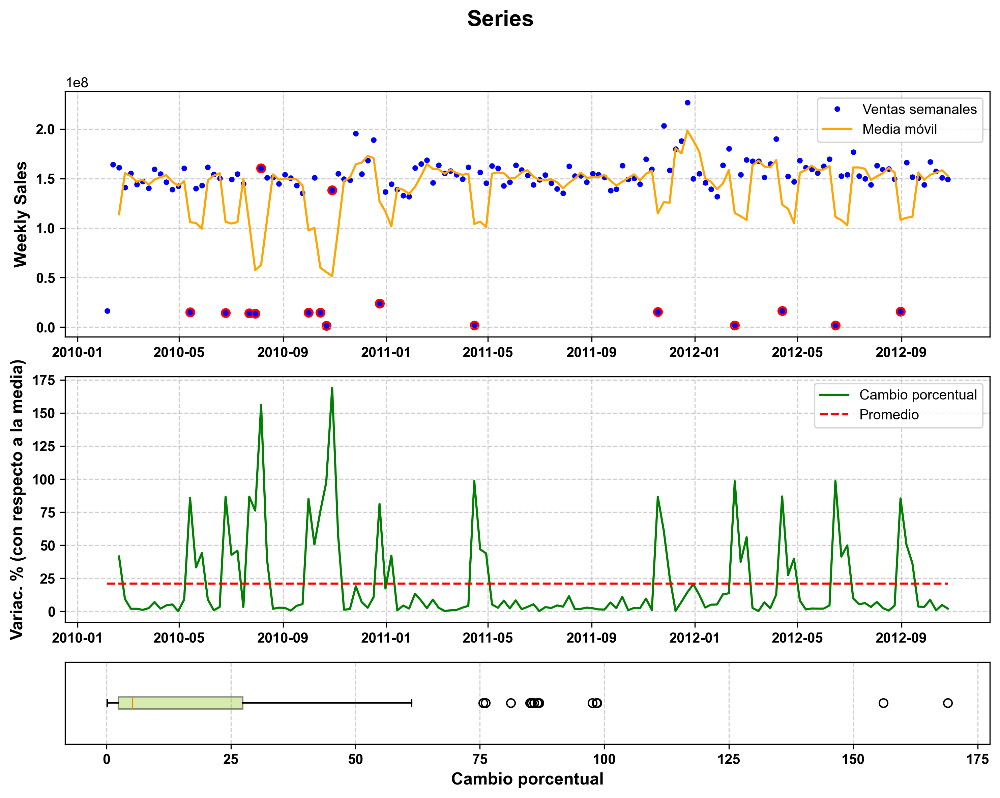

In [23]:
STS(df=df,
    store=1,
    window=3,
    porcentaje=61.3)

La figura permite observar los siguientes aspectos:

- **Serie temporal de ventas:** La serie de tiempo presenta valores atípicos que están por debajo de 0.5 x1e8. Estos valores destacan significativamente en comparación con el comportamiento general.

- **Media móvil:** La media móvil de 3 pasos refleja una tendencia estable a lo largo del tiempo. Sin embargo, se identifican picos que se desvían del comportamiento normal de la serie, los cuales coinciden con los valores atípicos mencionados previamente, es decir, aquellos por debajo de 0.5 x1e8.

- **Porcentaje de variación respecto a la media:** El porcentaje de variación oscila entre 0% y 175%, con un promedio cercano al 24%. Esto indica fluctuaciones significativas en los datos, aunque la mayoría de las variaciones se concentran cerca del promedio.

- **Diagrama de caja y bigotes:** Este gráfico muestra la presencia de valores atípicos por encima del 60%, los cuales corresponden a las ventas con comportamientos anómalos. Estos valores, resaltados en rojo en el gráfico superior, confirman su carácter atípico.

Vamos a seleccionar las filas que no cumplen con la condición de Store == 1 y Weekly_Sales < 0.5e8.

In [24]:
df = df.query('not (Store == 1 and Weekly_Sales < 0.5e8)')

**Veamos la tienda 2.**

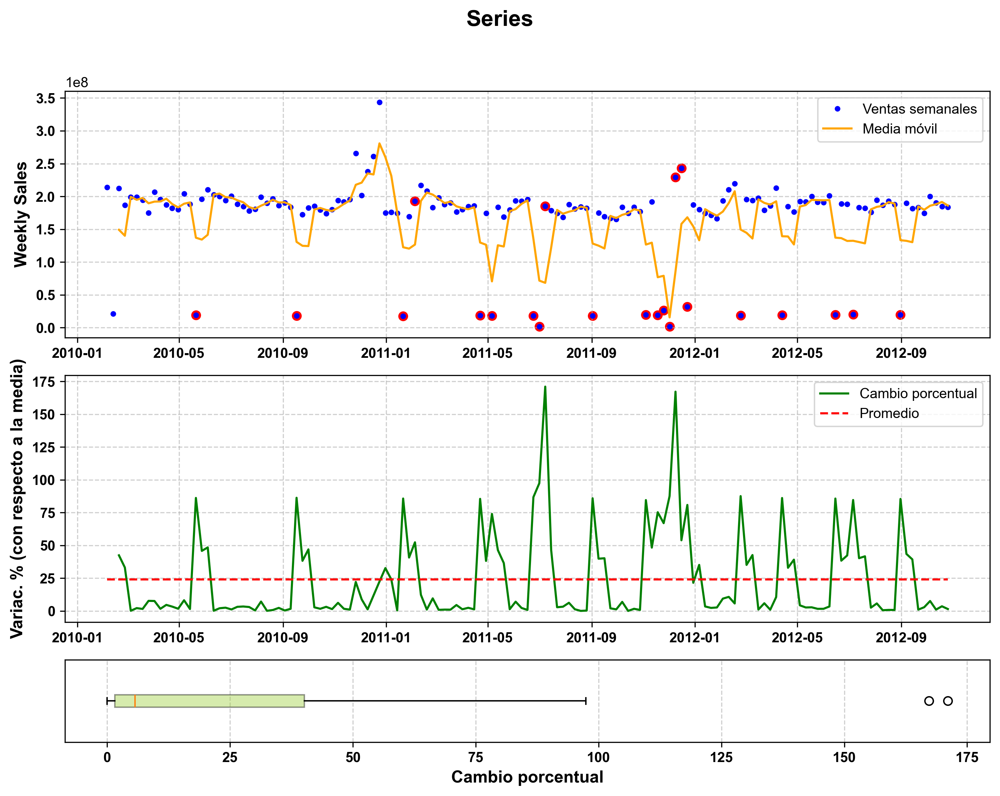

In [26]:
STS(df=df,
    store=2,
    window=3,
    porcentaje=50)

Observamos que en esta serie, el cambio porcentual muestra valores atípicos que superan el 80%. Los puntos marcados en rojo destacan los posibles valores atípicos identificados a través del cambio porcentual. No obstante, solo eliminaremos aquellos que estén por debajo de 0.5*1e8.

In [27]:
df = df.query('not (Store==2 and Weekly_Sales<0.5e8)')

**Veamos la tienda 3.**

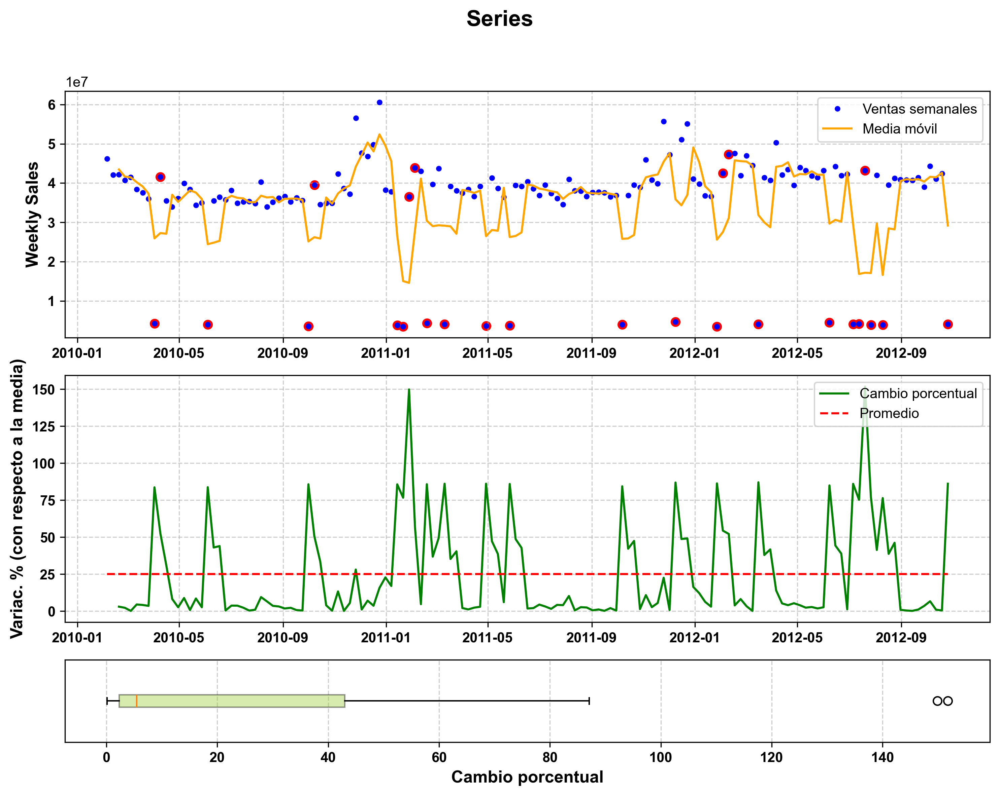

In [28]:
STS(df=df,
    store=3,
    window=3,
    porcentaje=50)

Aquí solo vamos a eliminar los que están por debajo de 1*1e7.

In [29]:
df = df.query('not (Store==3 and Weekly_Sales <1e7)')

**Veamos la tienda 4.**

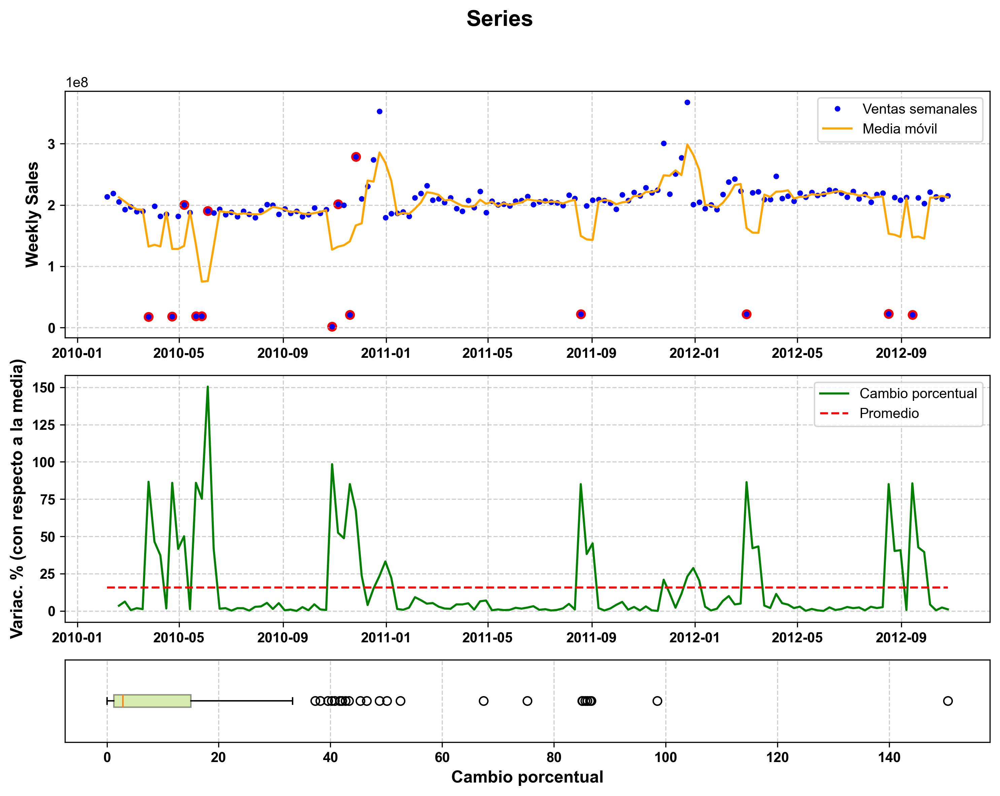

In [30]:
STS(df=df,
    store=4,
    window=3,
    porcentaje=50)

In [31]:
df = df.query('not (Store==4 and Weekly_Sales< 1e8)')

**Veamos la tienda 5.**

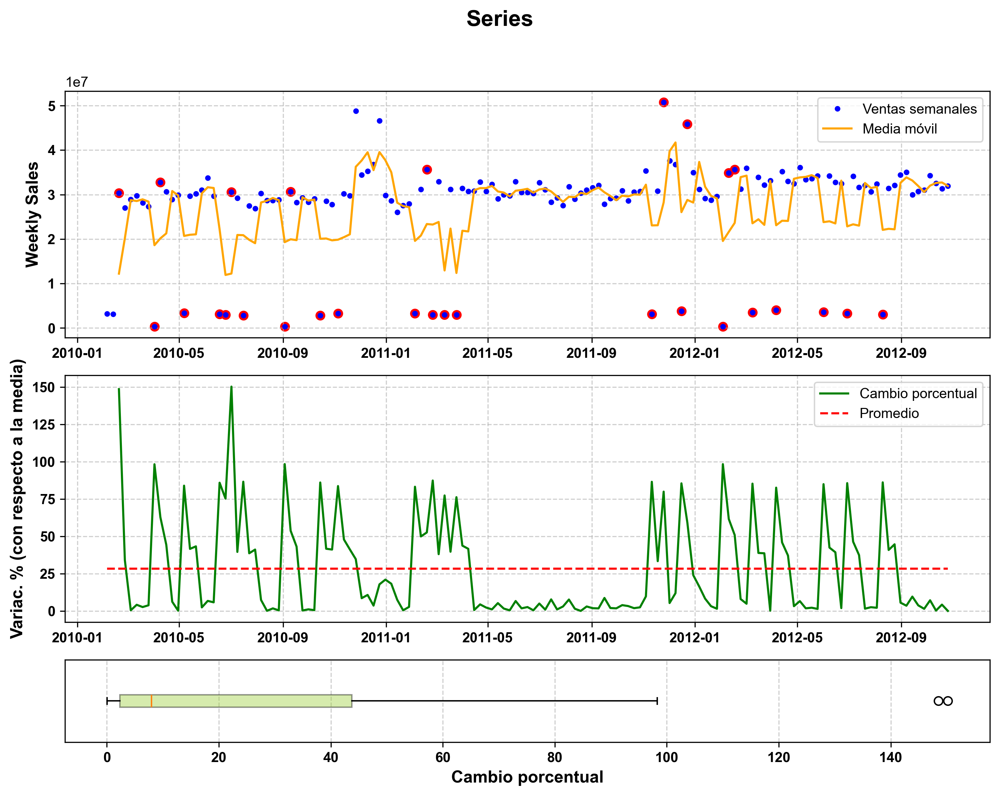

In [32]:
STS(df=df,
    store=5,
    window=3,
    porcentaje=50)

In [33]:
df = df.query('not (Store==5 and Weekly_Sales<1e7)')

**Veamos la tienda 6.**

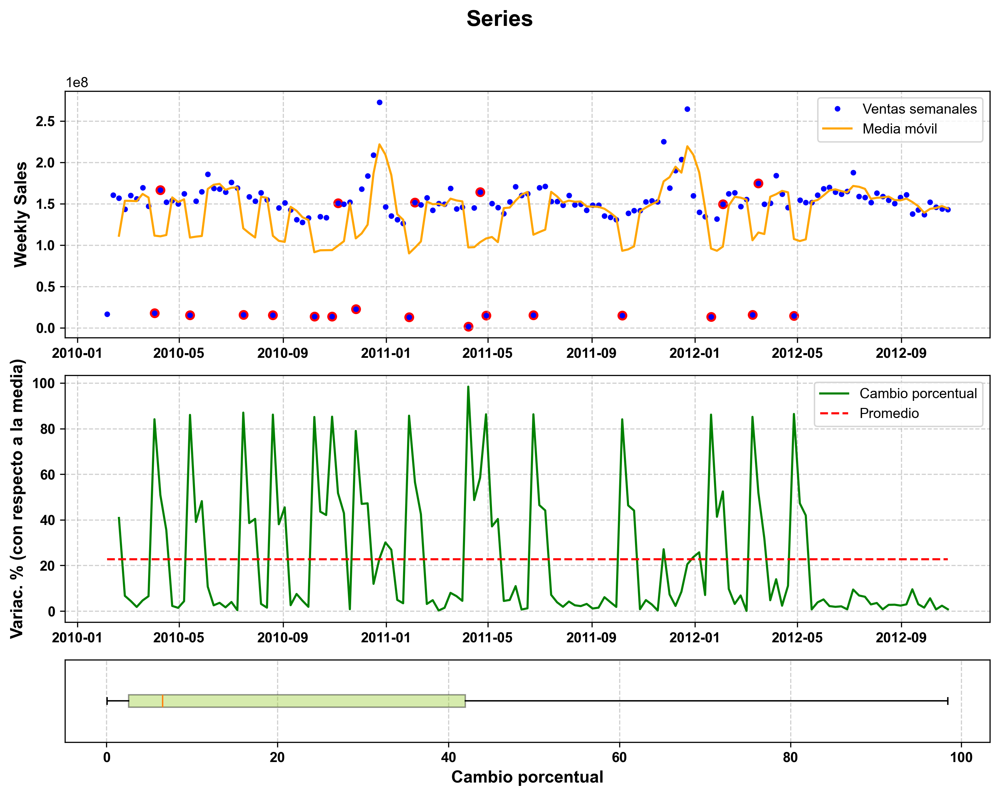

In [34]:
STS(df=df,
    store=6,
    window=3,
    porcentaje=50)

In [35]:
df = df.query('not (Store==6 and Weekly_Sales<0.5e8)')

**Veamos la tienda 7.**

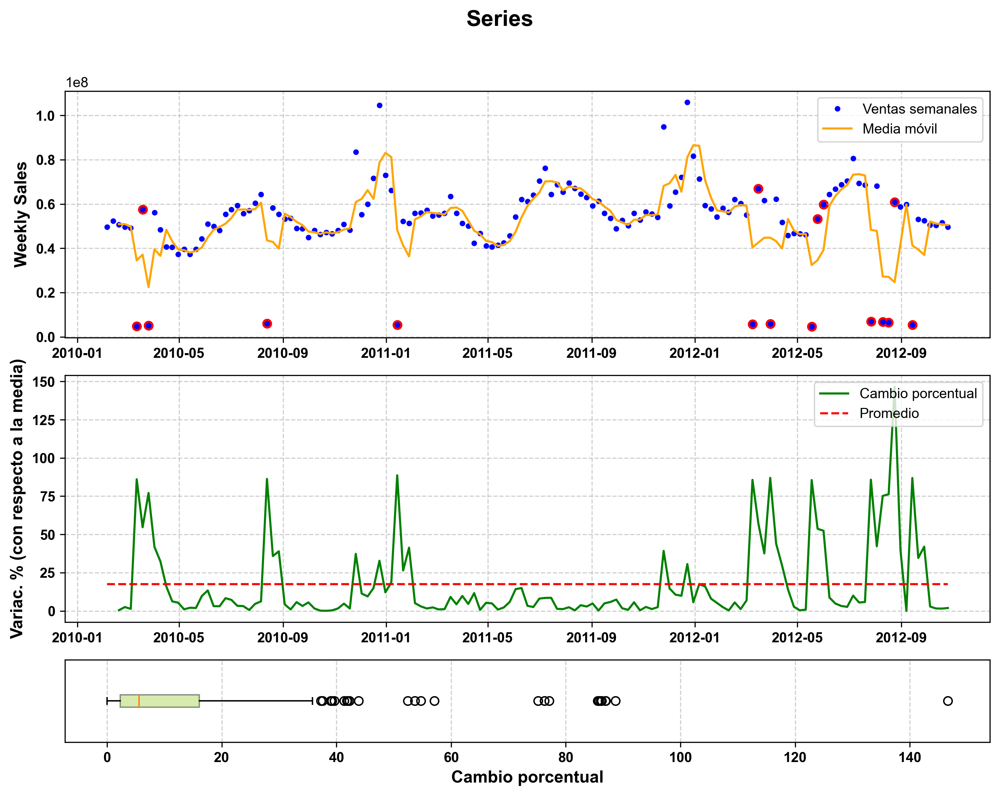

In [36]:
STS(df=df,
    store=7,
    window=3,
    porcentaje=50)

In [37]:
df = df.query('not (Store==7 and Weekly_Sales<0.2e8)')

**Veamos la tienda 8.**

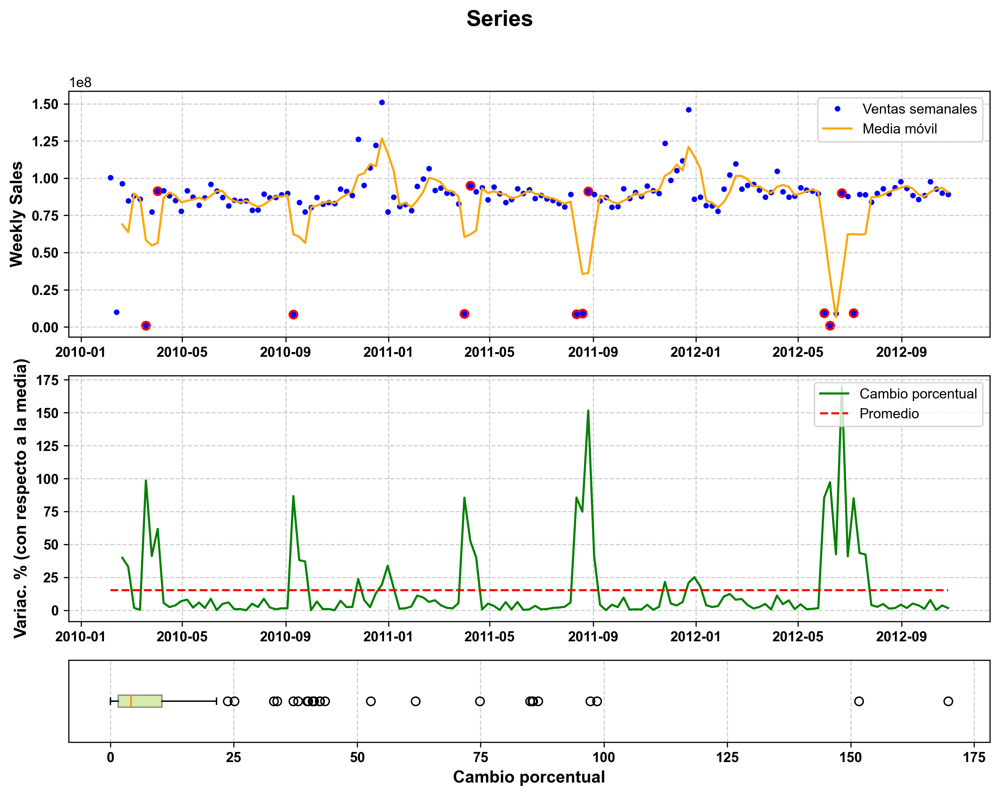

In [44]:
STS(df=df,
    store=8,
    window=3,
    porcentaje=50)

In [45]:
df = df.query('not (Store==8 and Weekly_Sales<0.25e8)')

**Veamos la tienda 9.**

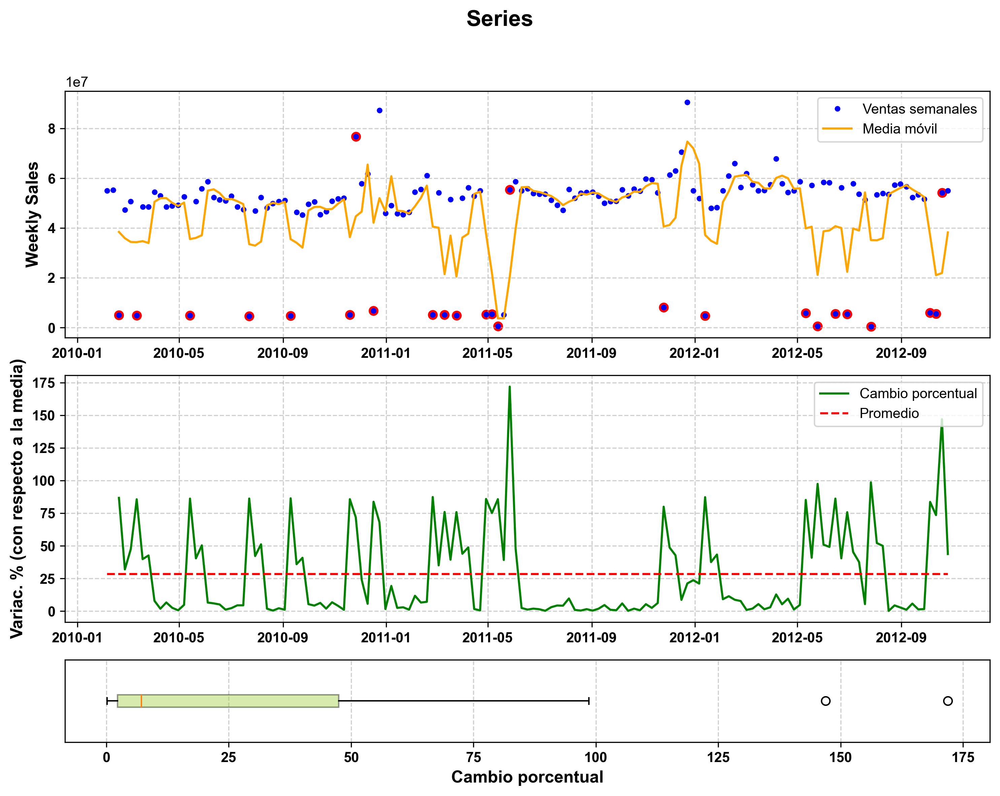

In [48]:
STS(df=df,
    store=9,
    window=3,
    porcentaje=70)

In [49]:
df = df.query('not (Store==9 and Weekly_Sales<2e7)')

**Veamos la tienda 10.**

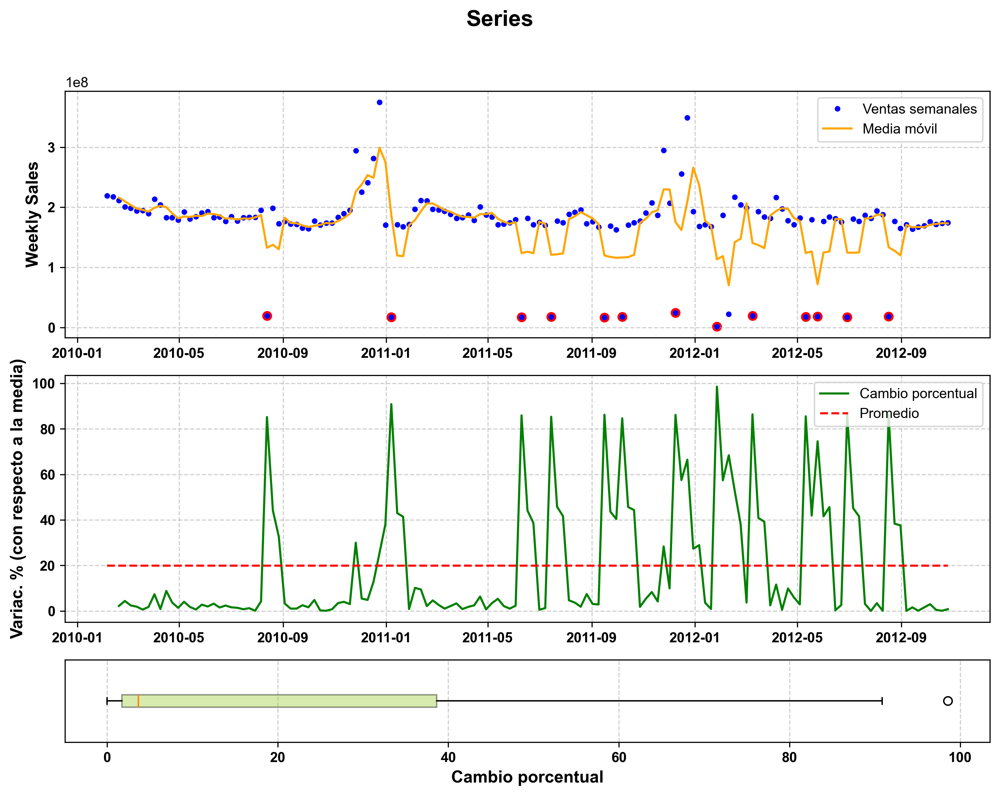

In [51]:
STS(df=df,
    store=10,
    window=3,
    porcentaje=70)

In [52]:
df = df.query('not (Store==10 and Weekly_Sales<1e8)')

**Veamos la tienda 11.**

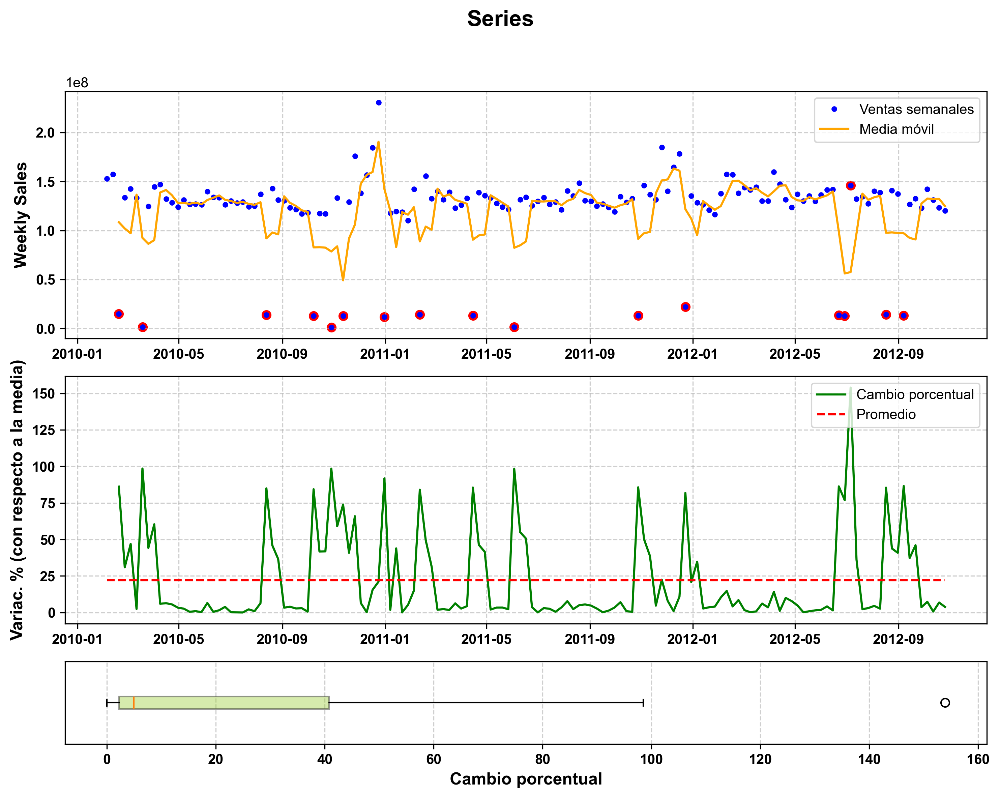

In [54]:
STS(df=df,
    store=11,
    window=3,
    porcentaje=70)

In [55]:
df = df.query('not (Store==11 and Weekly_Sales<0.5e8)')

**Veamos la tienda 12.**

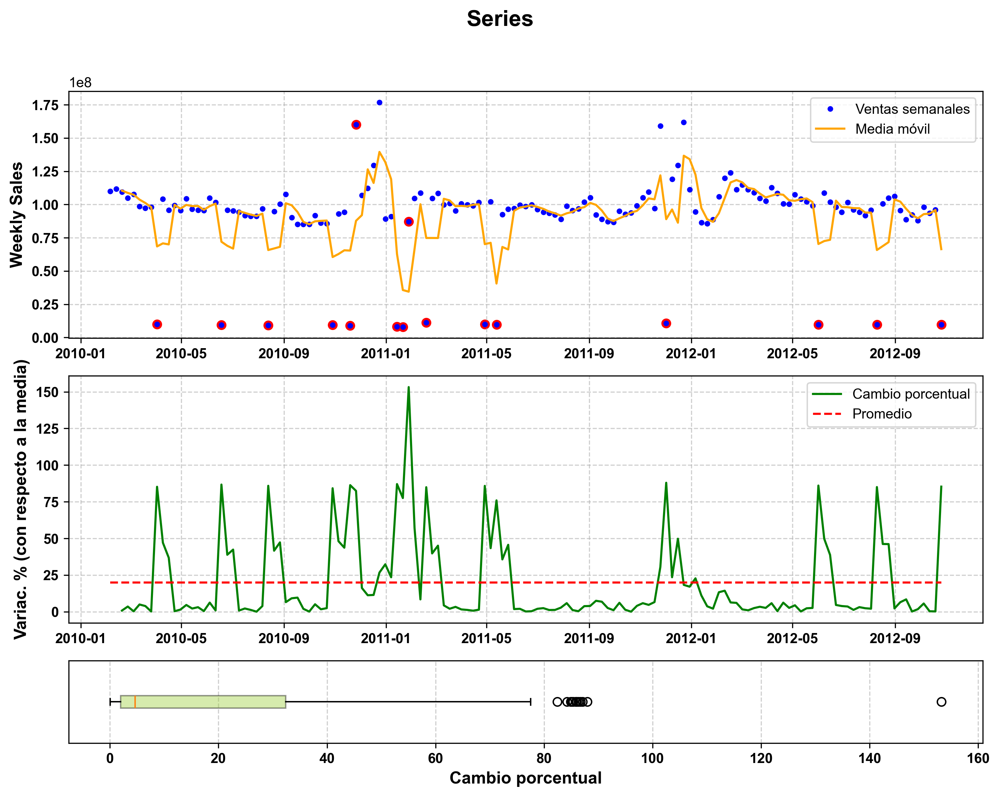

In [58]:
STS(df=df,
    store=12,
    window=3,
    porcentaje=60)

In [59]:
df = df.query('not (Store==12 and Weekly_Sales<0.25e8)')

**Veamos la tienda 13.**

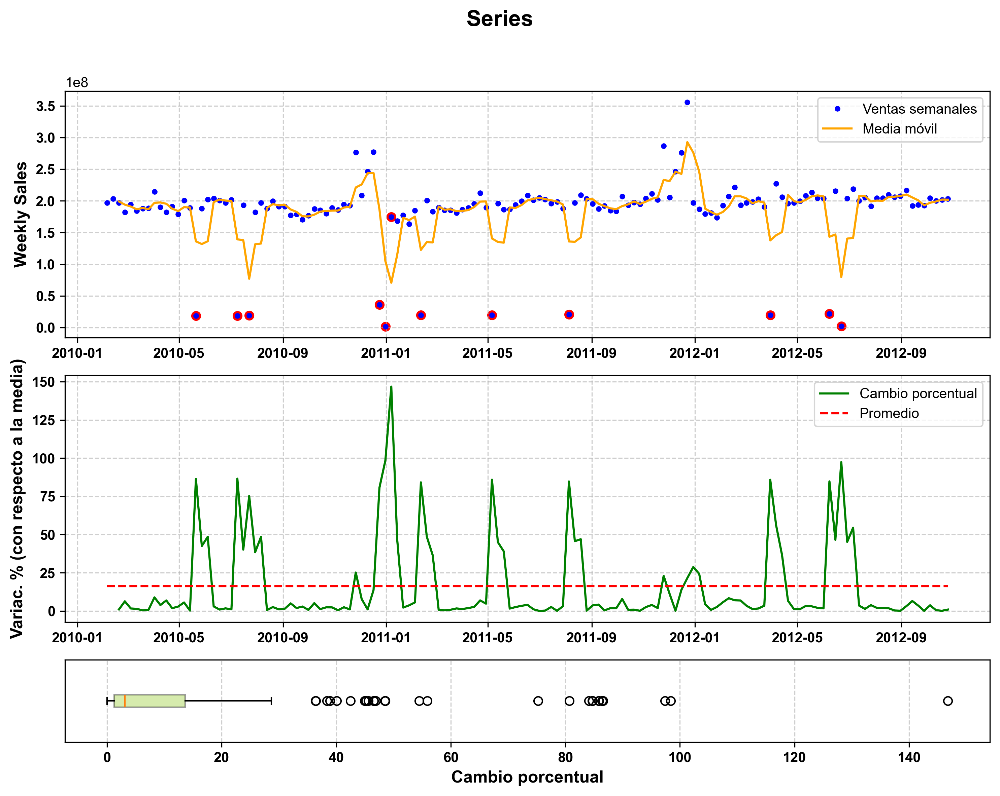

In [61]:
STS(df=df,
    store=13,
    window=3,
    porcentaje=60)

In [62]:
df = df.query('not (Store==13 and Weekly_Sales<0.5e8)')

**Veamos la tienda 14.**

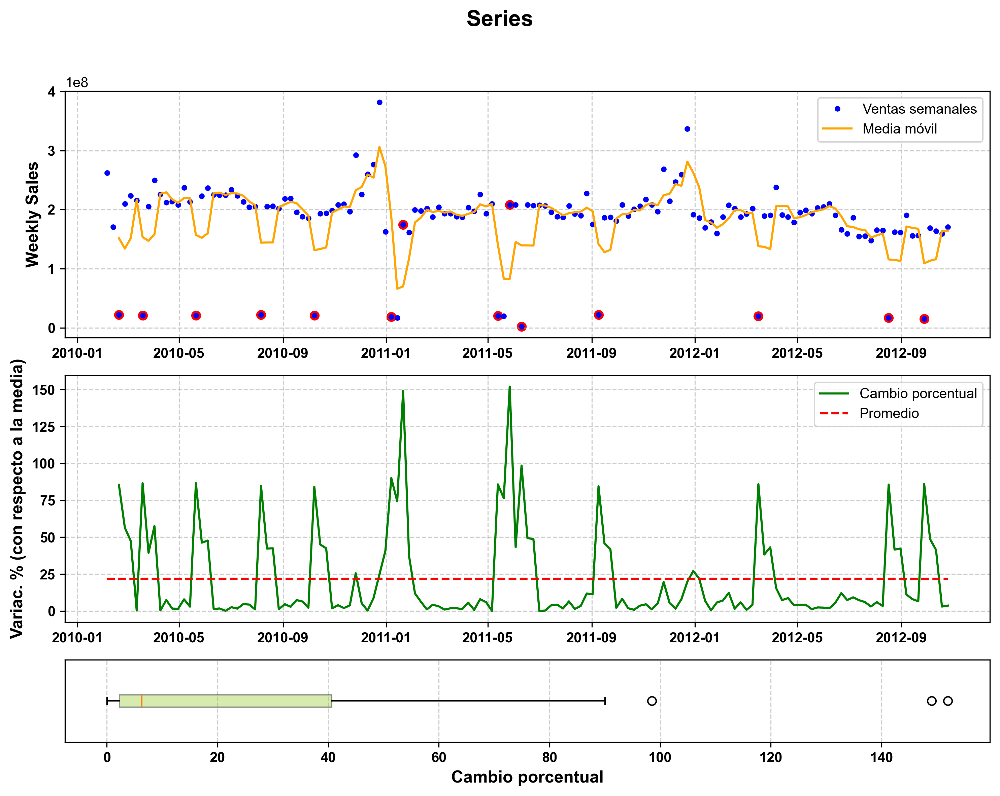

In [65]:
STS(df=df,
    store=14,
    window=3,
    porcentaje=80)

In [66]:
df = df.query('not (Store==14 and Weekly_Sales<1e8)')

**Veamos la tienda 15.**

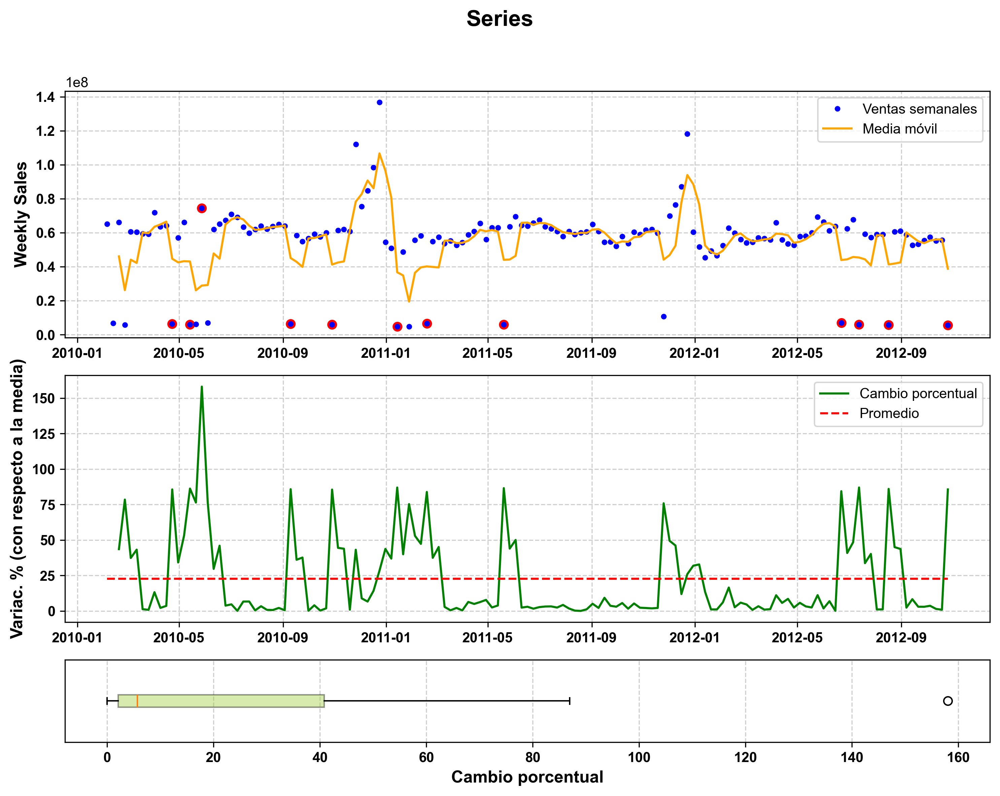

In [69]:
STS(df=df,
    store=15,
    window=3,
    porcentaje=80)

In [70]:
df = df.query('not (Store==15 and Weekly_Sales<0.2e8)')

**Veamos la tienda 16.**

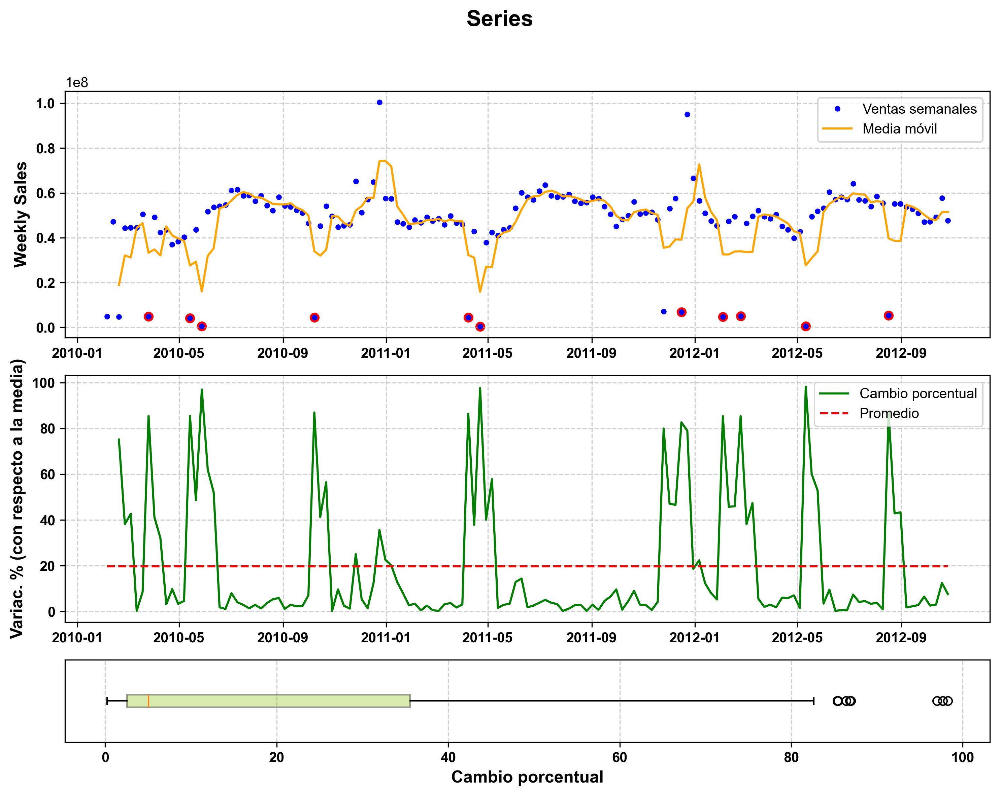

In [74]:
STS(df=df,
    store=16,
    window=3,
    porcentaje=80)

In [75]:
df = df.query('not (Store==16 and Weekly_Sales<0.2e8)')

**Veamos la tienda 17.**

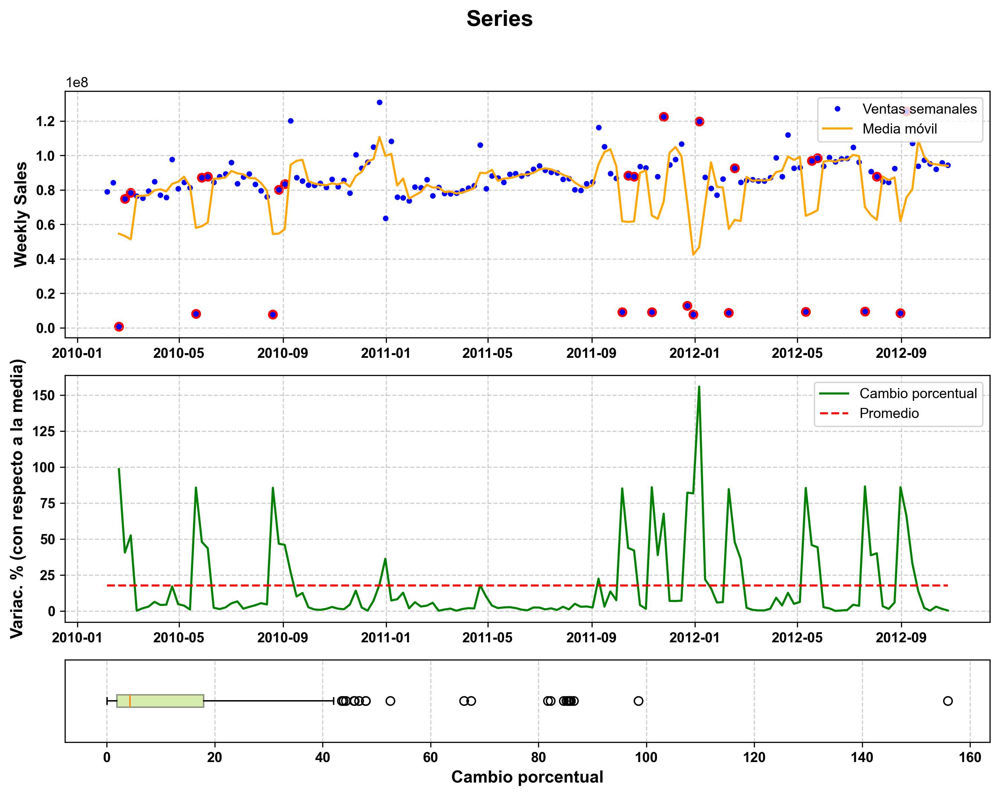

In [78]:
STS(df=df,
    store=17,
    window=3,
    porcentaje=40)

In [79]:
df = df.query('not (Store==17 and Weekly_Sales<0.2e8)')

**Veamos la tienda 18.**

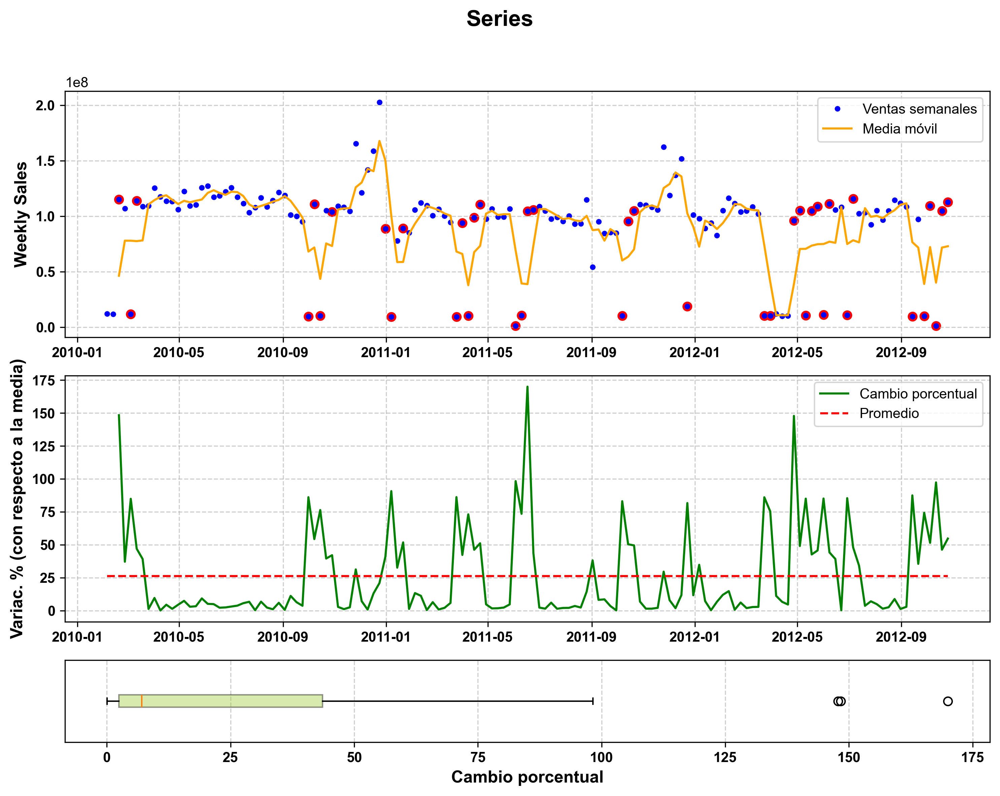

In [81]:
STS(df=df,
    store=18,
    window=3,
    porcentaje=40)

In [82]:
df = df.query('not (Store==18 and Weekly_Sales<0.5e8)')

**Veamos la tienda 19.**

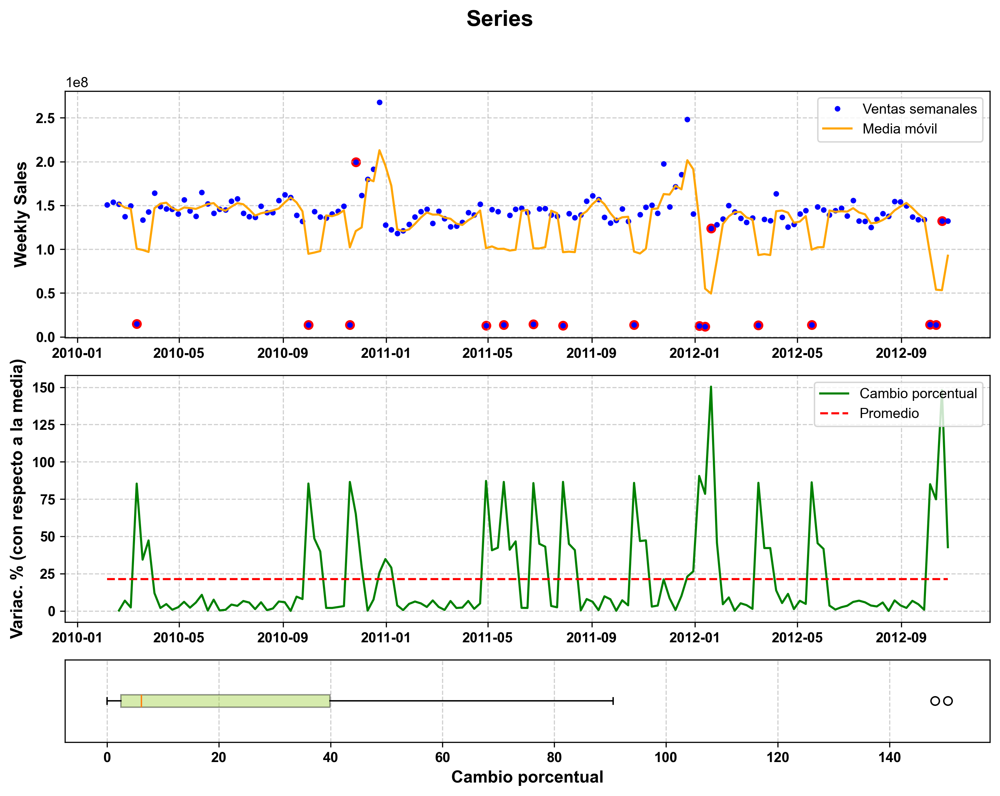

In [86]:
STS(df=df,
    store=19,
    window=3,
    porcentaje=60)

In [87]:
df = df.query('not (Store==19 and Weekly_Sales<0.5e8)')

**Veamos la tienda 20.**

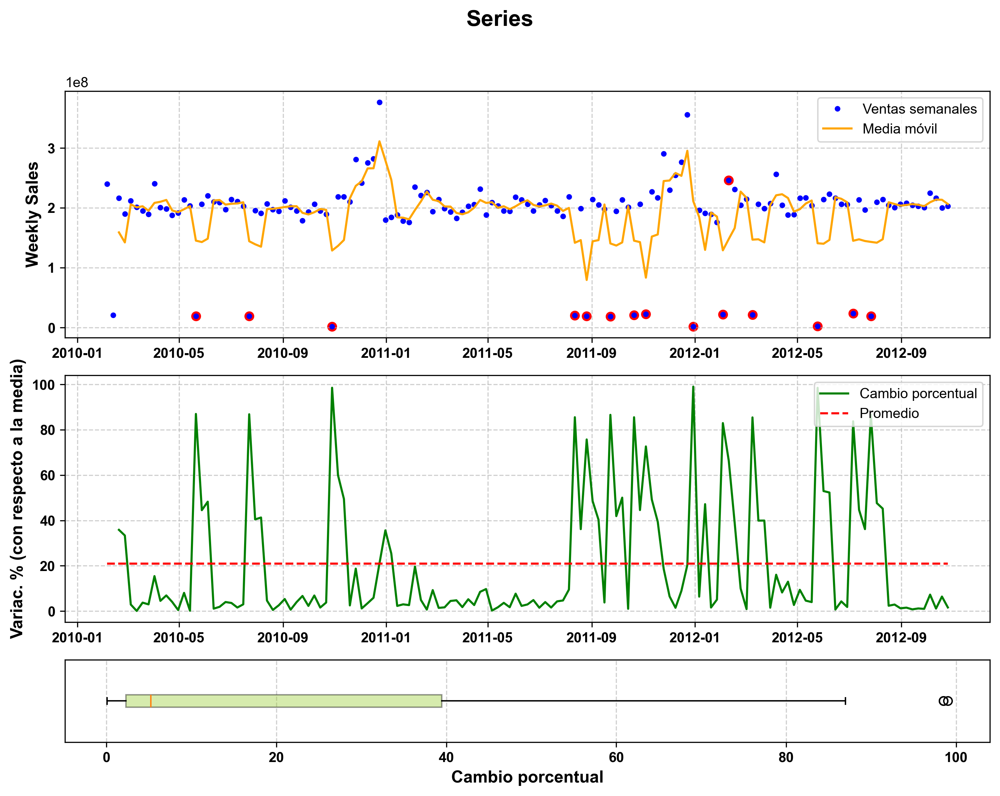

In [89]:
STS(df=df,
    store=20,
    window=3,
    porcentaje=60)

In [90]:
df = df.query('not (Store==20 and Weekly_Sales<1e8)')

**Veamos la tienda 21.**

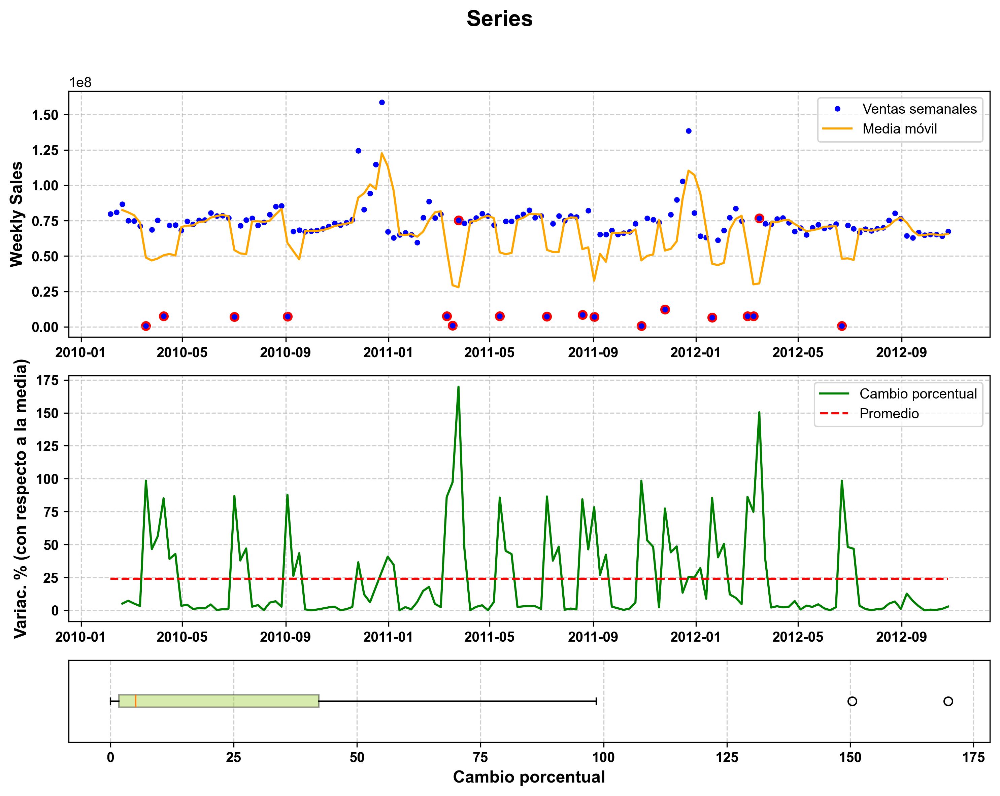

In [92]:
STS(df=df,
    store=21,
    window=3,
    porcentaje=60)

In [93]:
df = df.query('not (Store==21 and Weekly_Sales<0.25e8)')

**Veamos la tienda 22.**

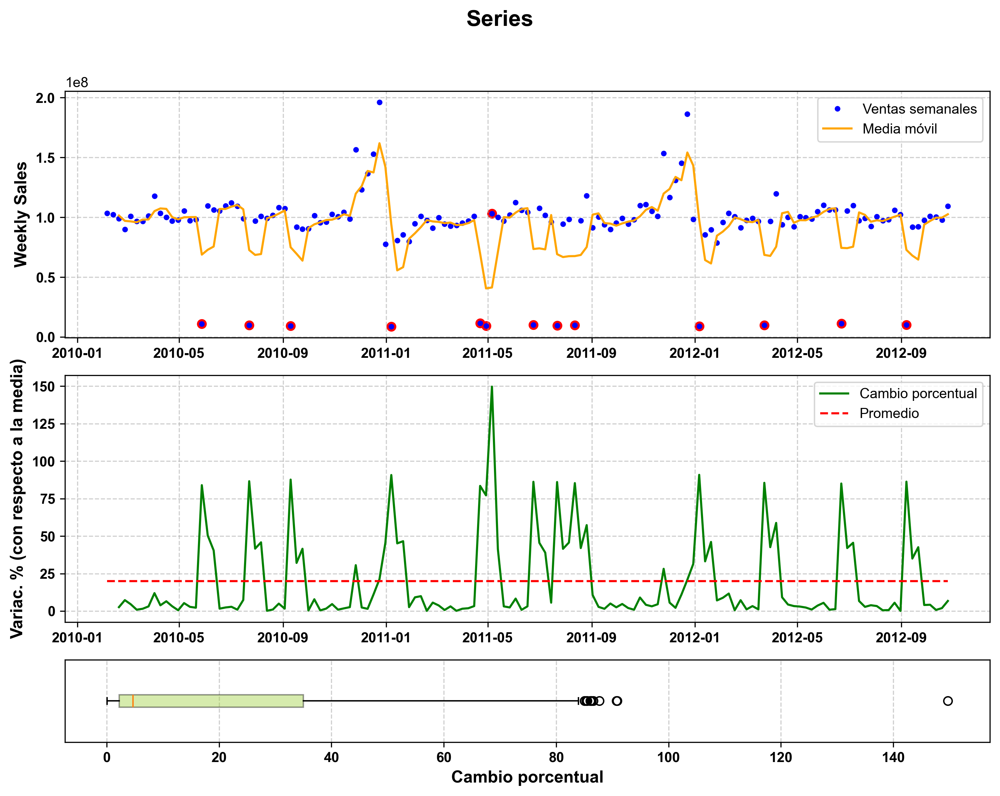

In [95]:
STS(df=df,
    store=22,
    window=3,
    porcentaje=60)

In [96]:
df = df.query('not (Store==22 and Weekly_Sales<0.5e8)')

**Veamos la tienda 23.**

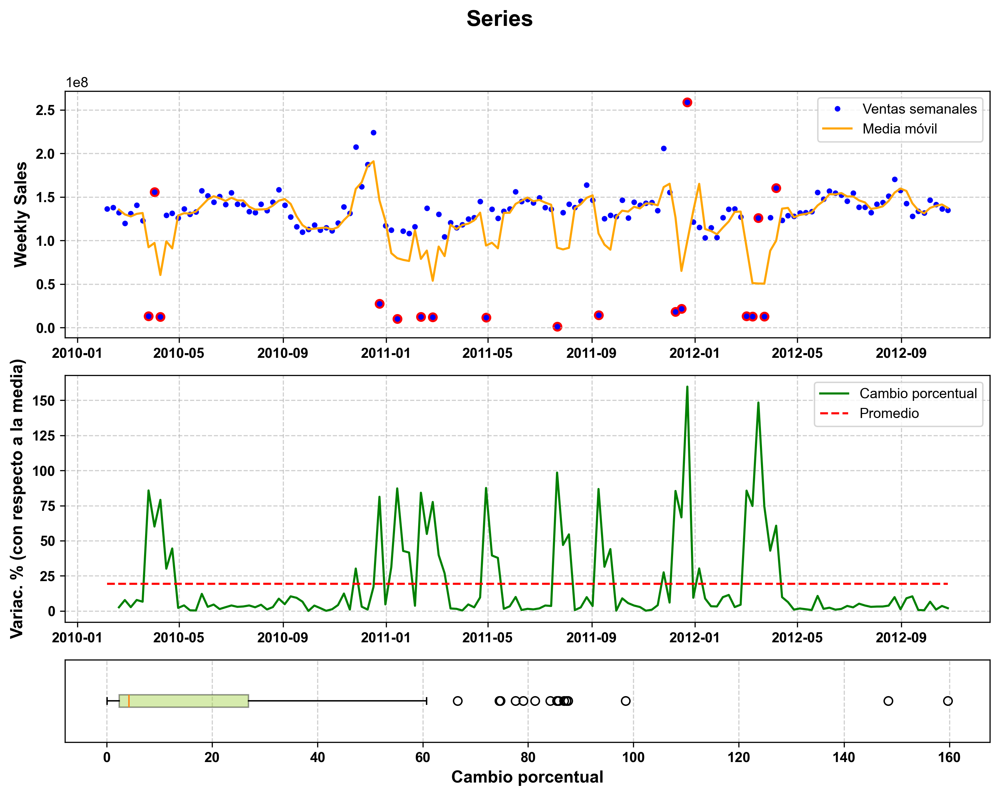

In [98]:
STS(df=df,
    store=23,
    window=3,
    porcentaje=60)

In [99]:
df = df.query('not (Store==23 and Weekly_Sales<0.5e8)')

**Veamos la tienda 24.**

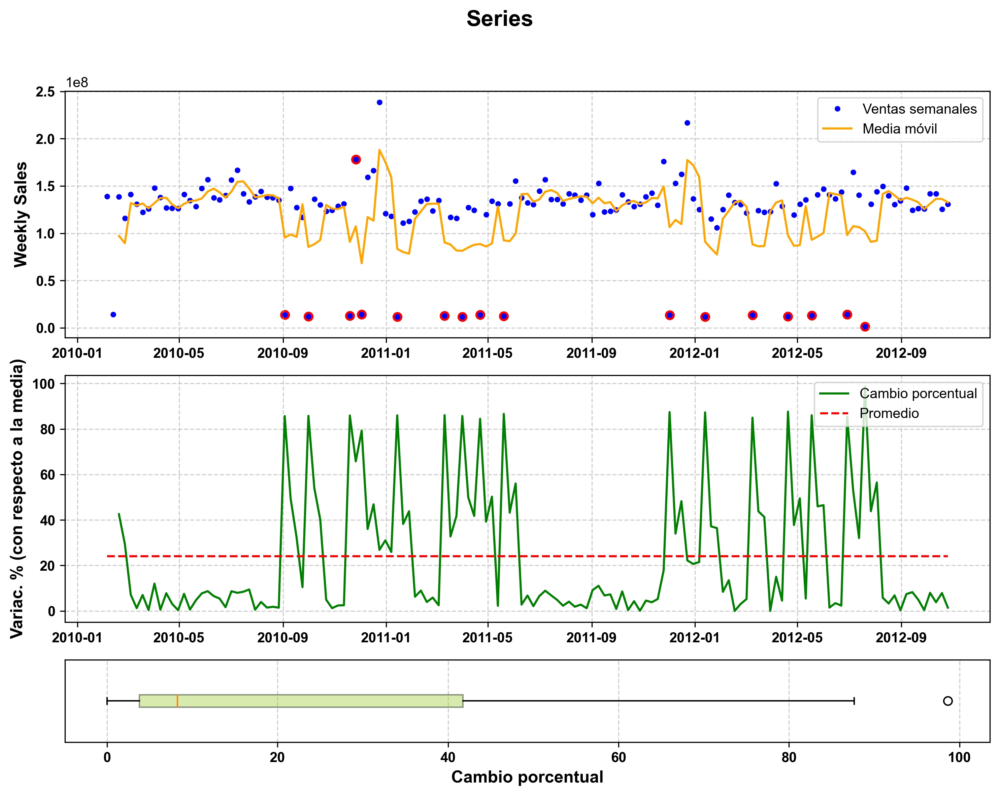

In [101]:
STS(df=df,
    store=24,
    window=3,
    porcentaje=60)

In [102]:
df = df.query('not (Store==24 and Weekly_Sales<0.5e8)')

**Veamos la tienda 25.**

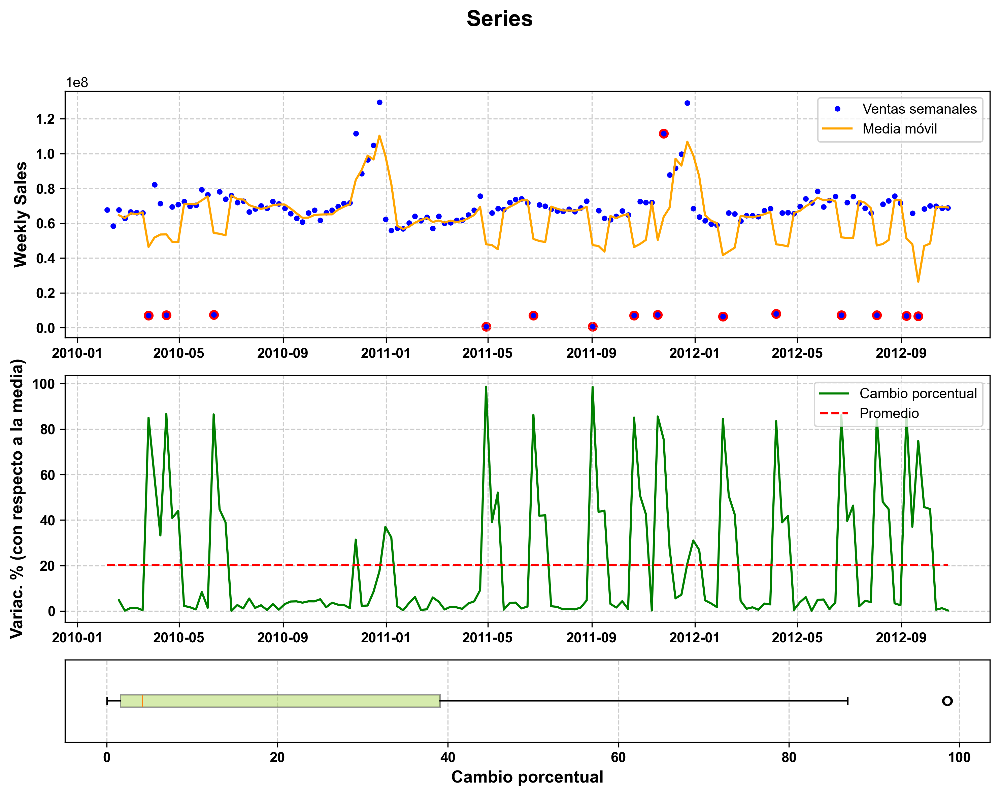

In [104]:
STS(df=df,
    store=25,
    window=3,
    porcentaje=60)

In [105]:
df = df.query('not (Store==25 and Weekly_Sales<0.2e8)')

**Veamos la tienda 26.**

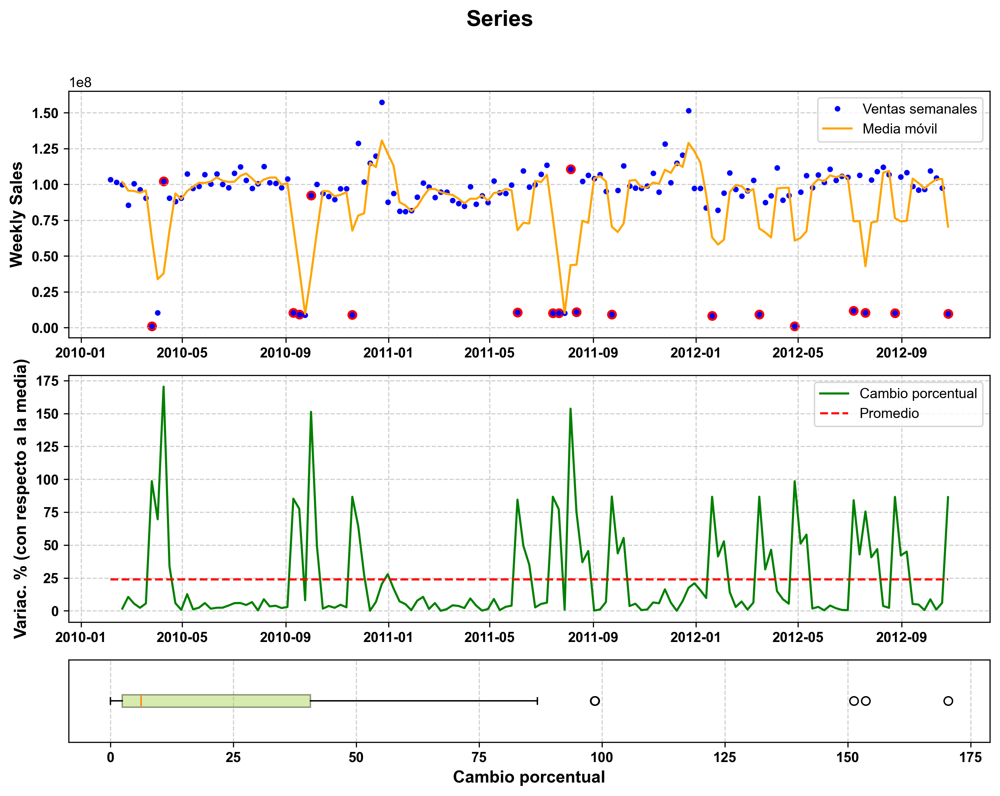

In [109]:
STS(df=df,
    store=26,
    window=3,
    porcentaje=75)

In [110]:
df = df.query('not (Store==26 and Weekly_Sales<0.25e8)')

**Veamos la tienda 27.**

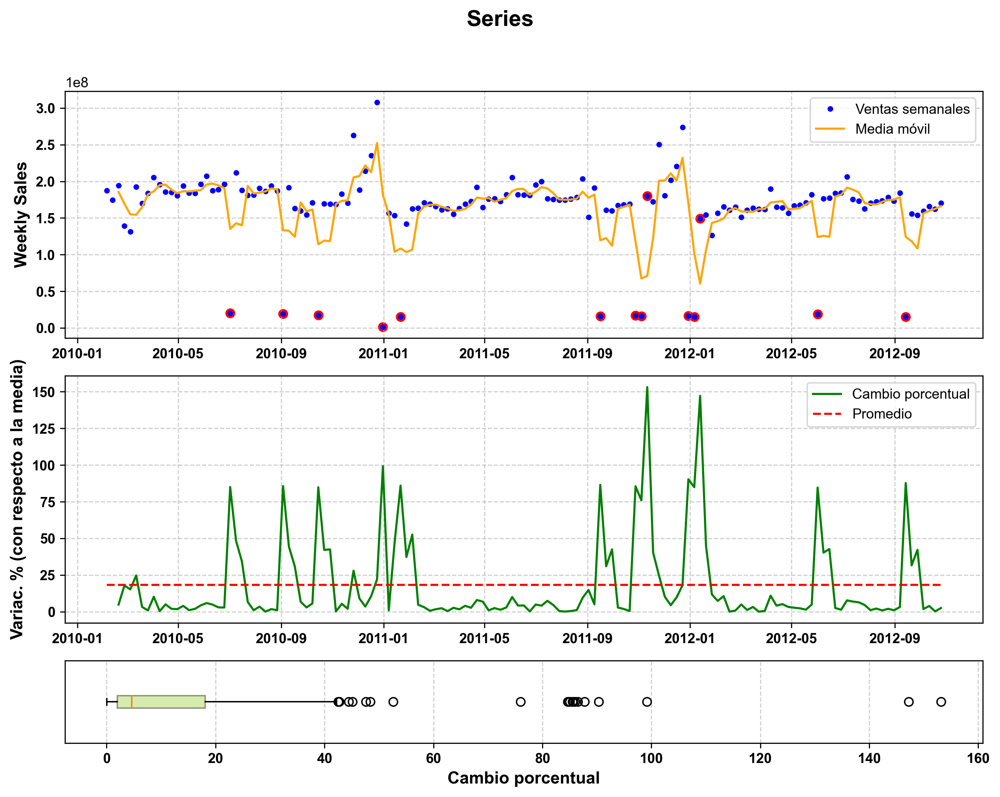

In [114]:
STS(df=df,
    store=27,
    window=3,
    porcentaje=60)

In [115]:
df = df.query('not (Store==27 and Weekly_Sales<0.5e8)')

**Veamos la tienda 28.**

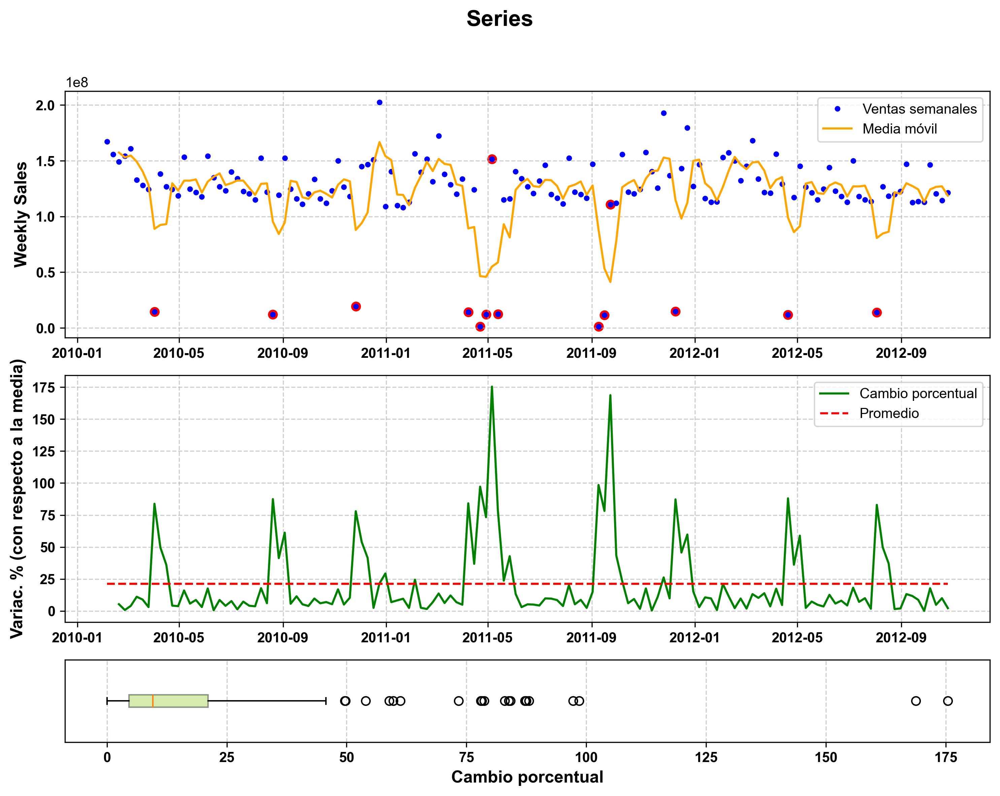

In [118]:
STS(df=df,
    store=28,
    window=3,
    porcentaje=70)

In [119]:
df = df.query('not (Store==28 and Weekly_Sales<0.5e8)')

**Veamos la tienda 29.**

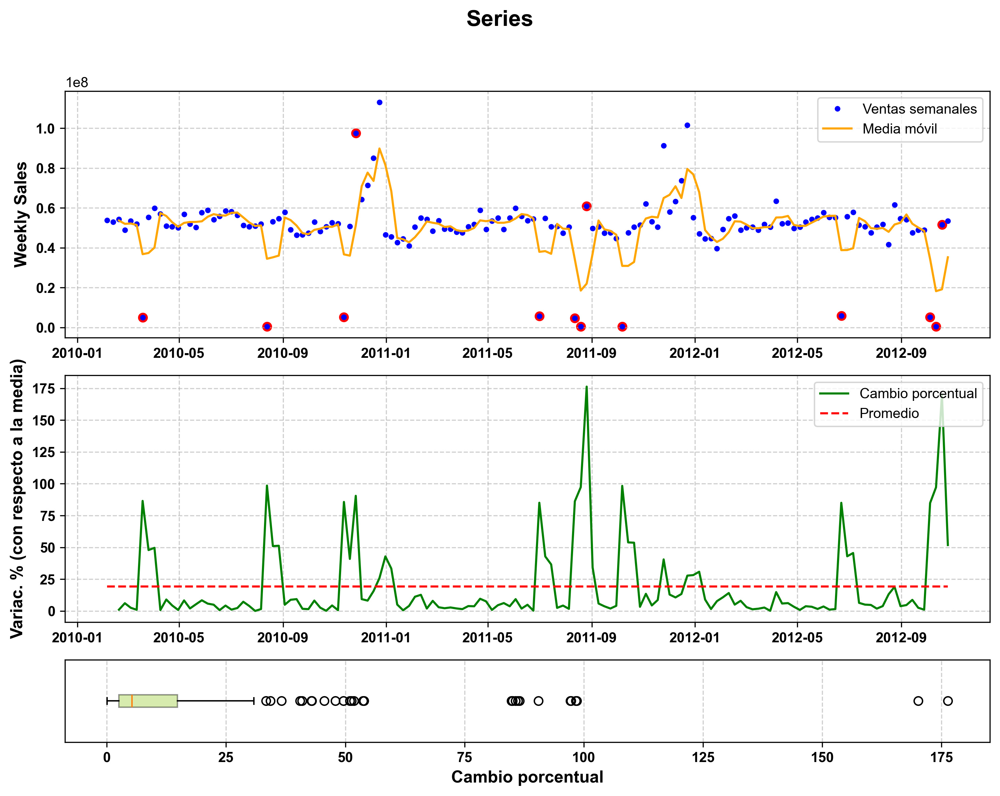

In [123]:
STS(df=df,
    store=29,
    window=3,
    porcentaje=60)

In [124]:
df = df.query('not (Store==29 and Weekly_Sales<0.2e8)')

**Veamos la tienda 30.**

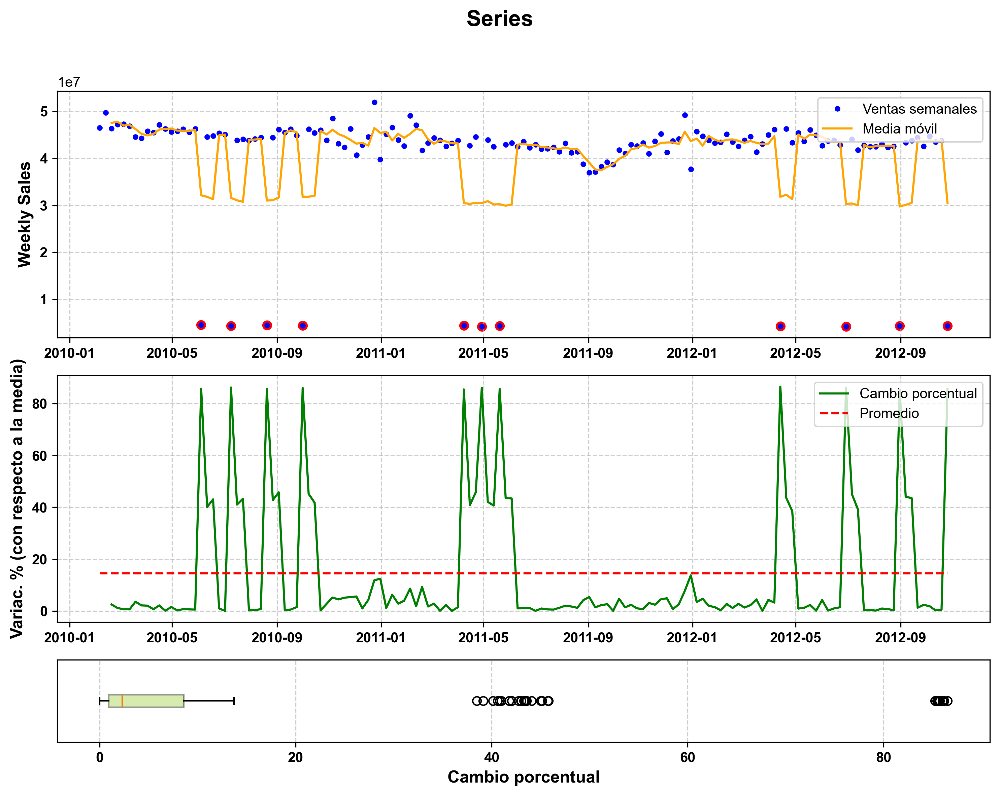

In [127]:
STS(df=df,
    store=30,
    window=3,
    porcentaje=60)

In [128]:
df = df.query('not (Store==30 and Weekly_Sales<1e7)')

**Veamos la tienda 31.**

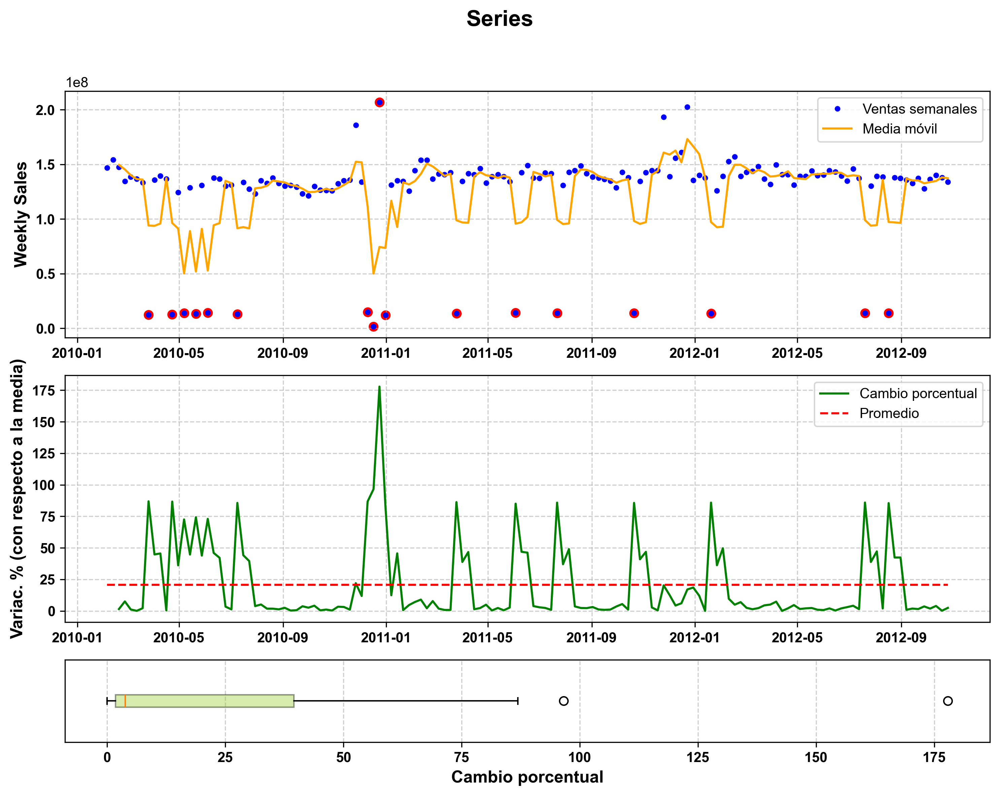

In [130]:
STS(df=df,
    store=31,
    window=3,
    porcentaje=60)

In [131]:
df = df.query('not (Store==31 and Weekly_Sales<0.5e8)')

**Veamos la tienda 32.**

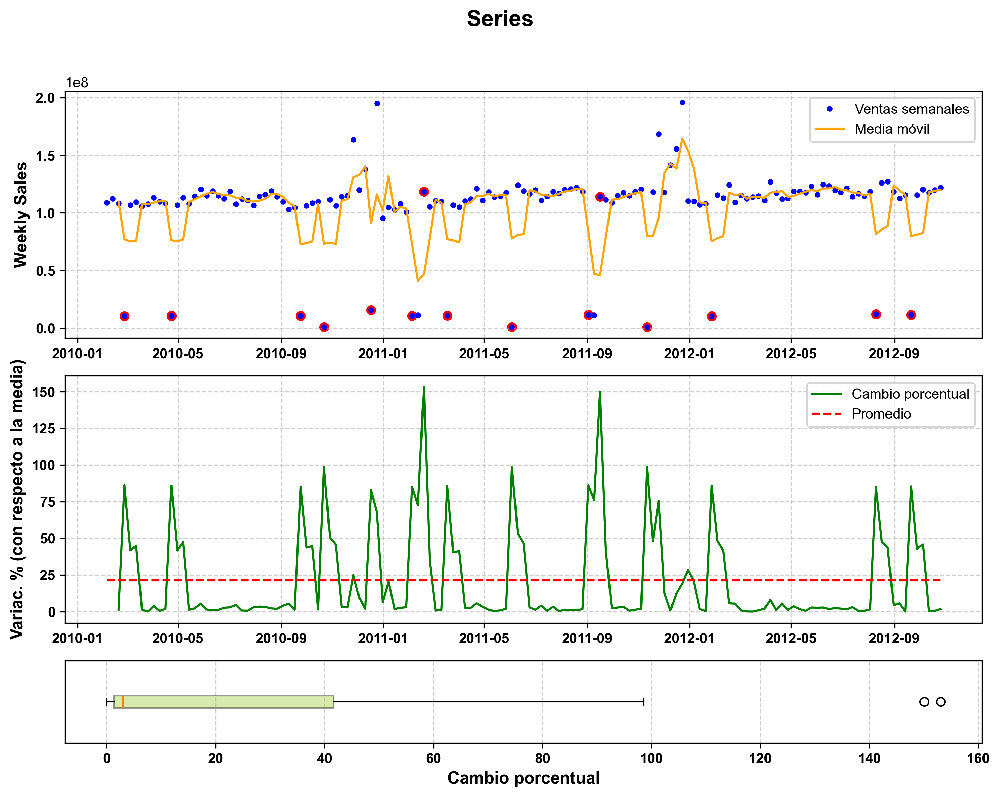

In [135]:
STS(df=df,
    store=32,
    window=3,
    porcentaje=80)

In [136]:
df = df.query('not (Store==32 and Weekly_Sales<0.5e8)')

**Veamos la tienda 33.**

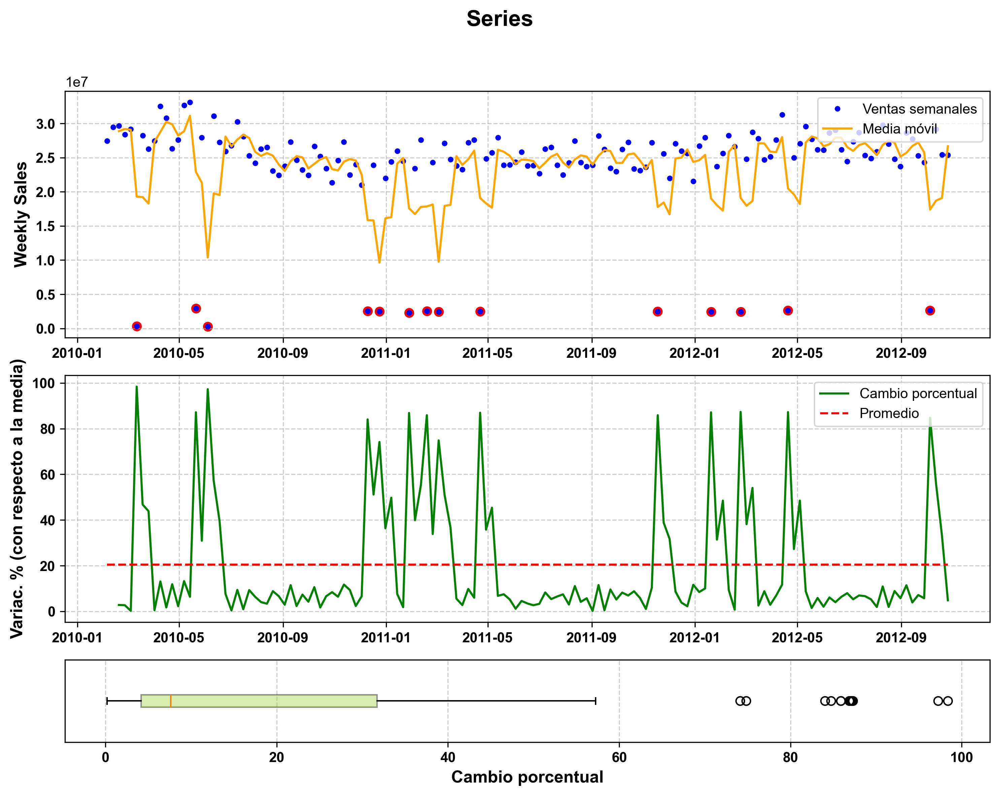

In [139]:
STS(df=df,
    store=33,
    window=3,
    porcentaje=60)

In [140]:
df = df.query('not (Store==33 and Weekly_Sales<1e7)')

**Veamos la tienda 34.**

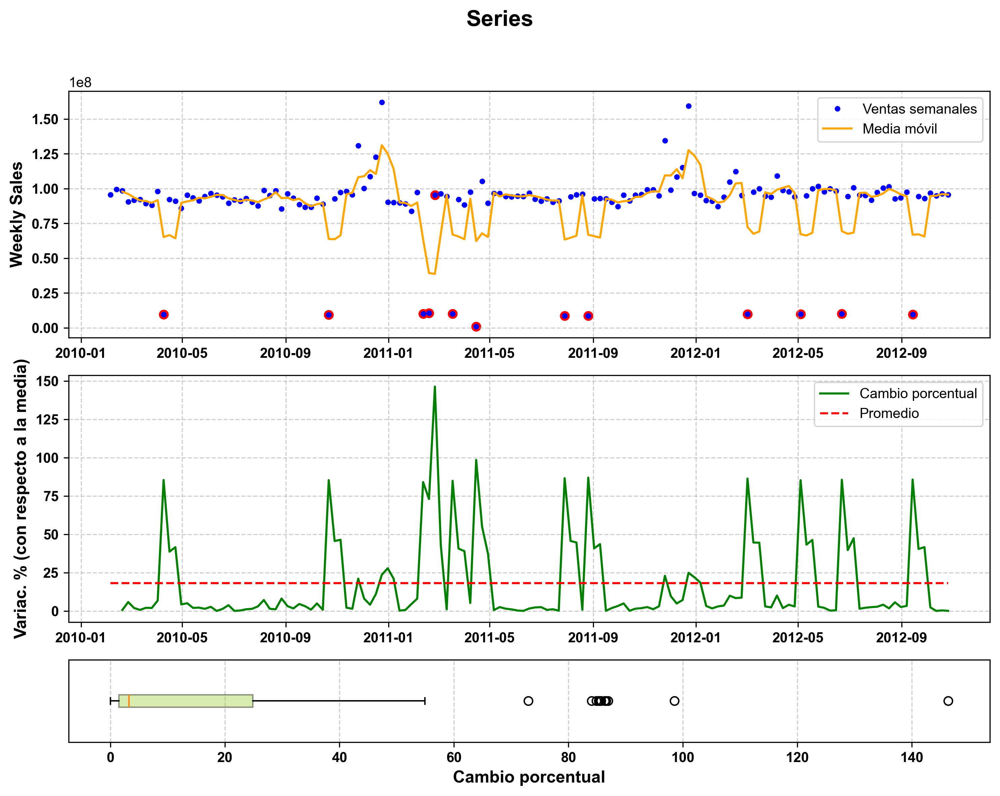

In [145]:
STS(df=df,
    store=34,
    window=3,
    porcentaje=60)

In [146]:
df = df.query('not (Store==34 and Weekly_Sales<0.25e8)')

**Veamos la tienda 35.**

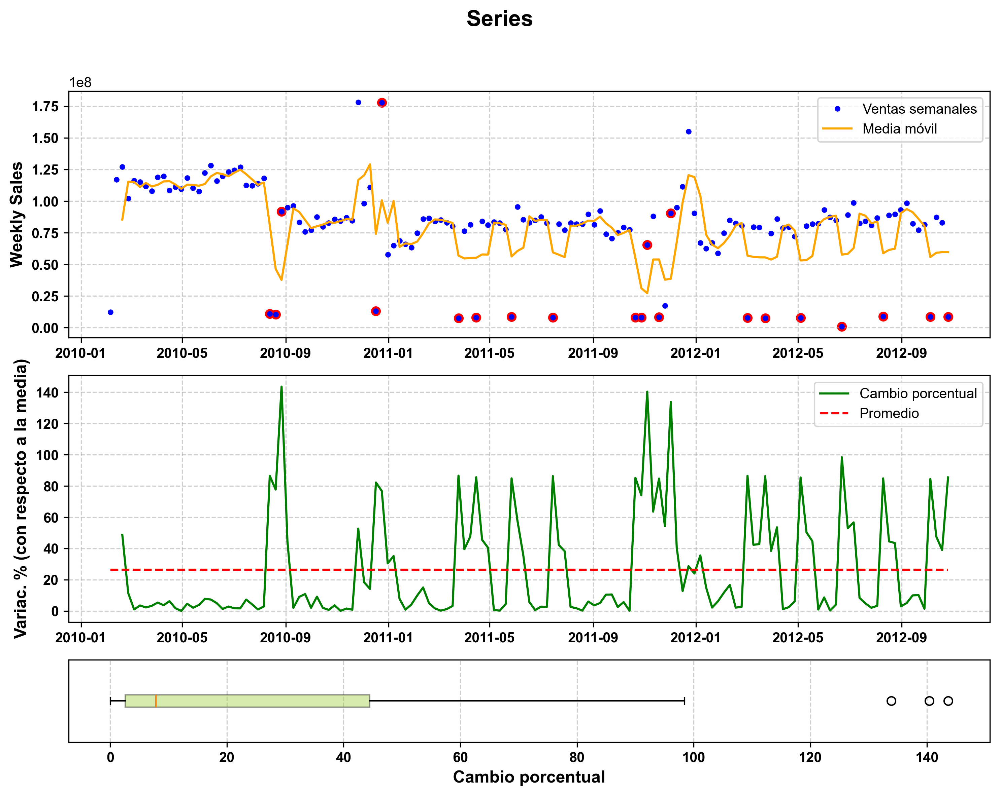

In [151]:
STS(df=df,
    store=35,
    window=3,
    porcentaje=70)

In [152]:
df = df.query('not (Store==35 and Weekly_Sales<0.25e8)')

**Veamos la tienda 36.**

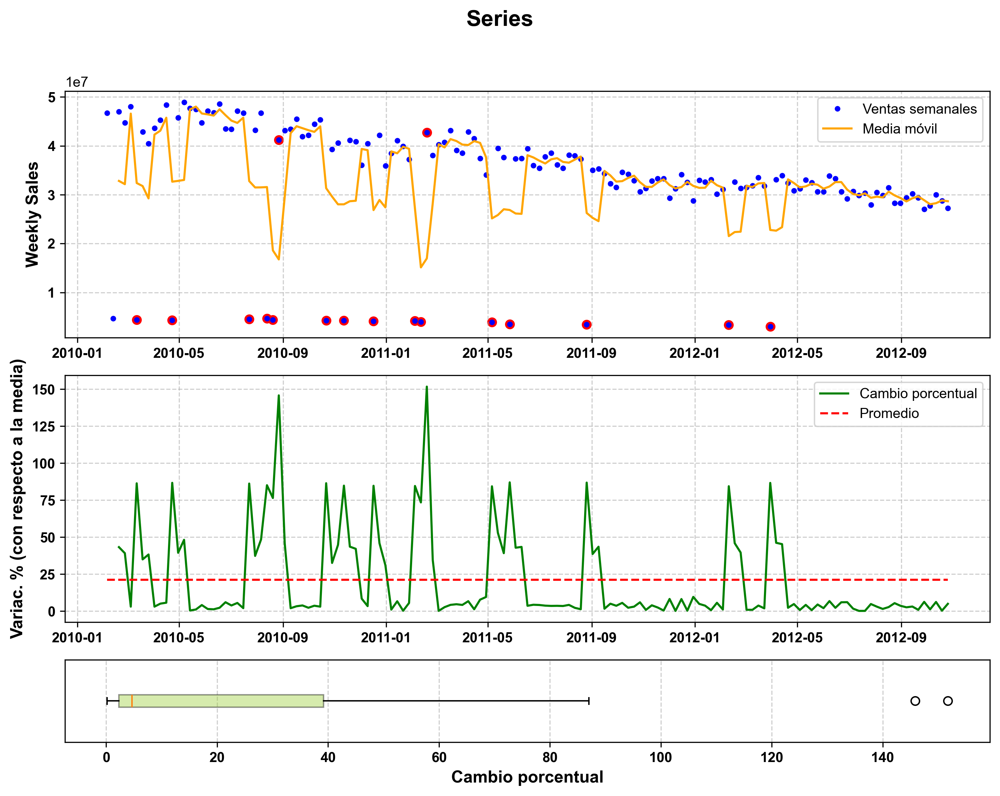

In [154]:
STS(df=df,
    store=36,
    window=3,
    porcentaje=70)

In [155]:
df = df.query('not (Store==36 and Weekly_Sales<1e7)')

**Veamos la tienda 37.**

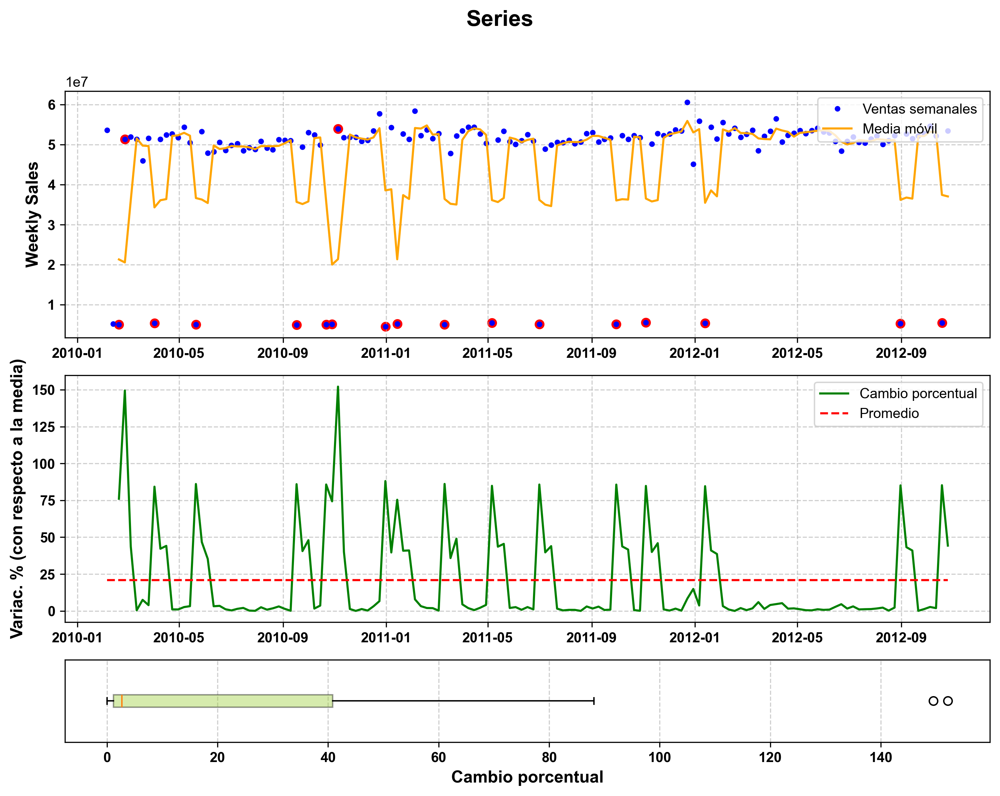

In [157]:
STS(df=df,
    store=37,
    window=3,
    porcentaje=70)

In [158]:
df = df.query('not (Store==37 and Weekly_Sales<1e7)')

**Veamos la tienda 38.**

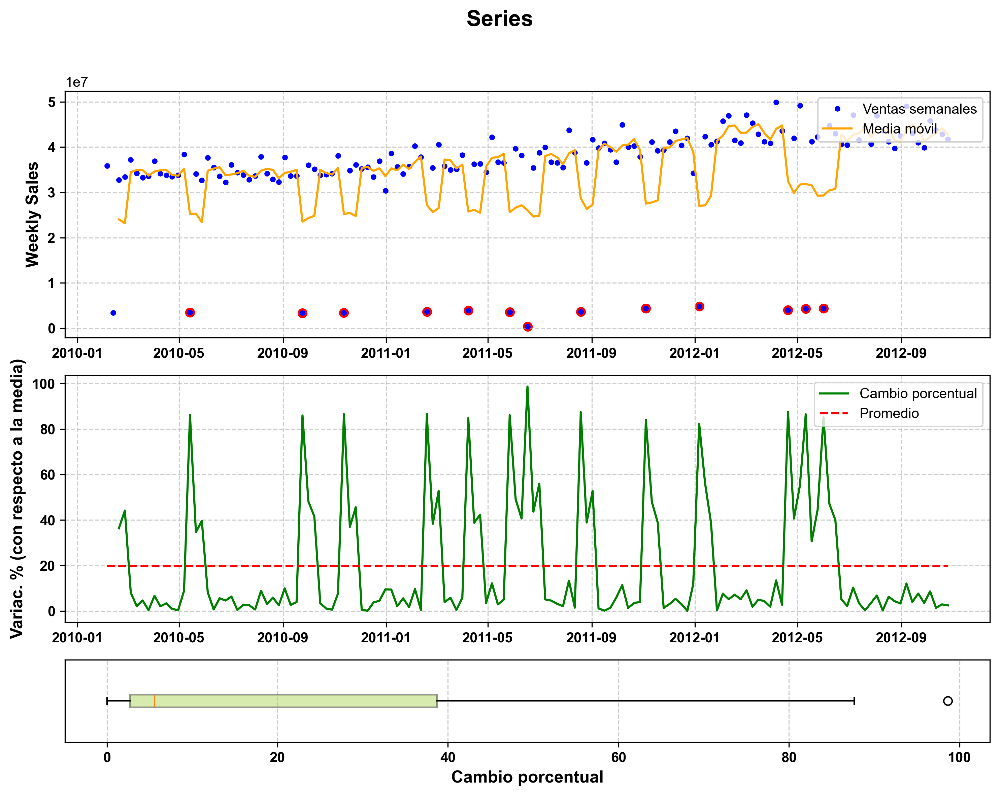

In [160]:
STS(df=df,
    store=38,
    window=3,
    porcentaje=70)

In [161]:
df = df.query('not (Store==38 and Weekly_Sales<1e7)')

**Veamos la tienda 39.**

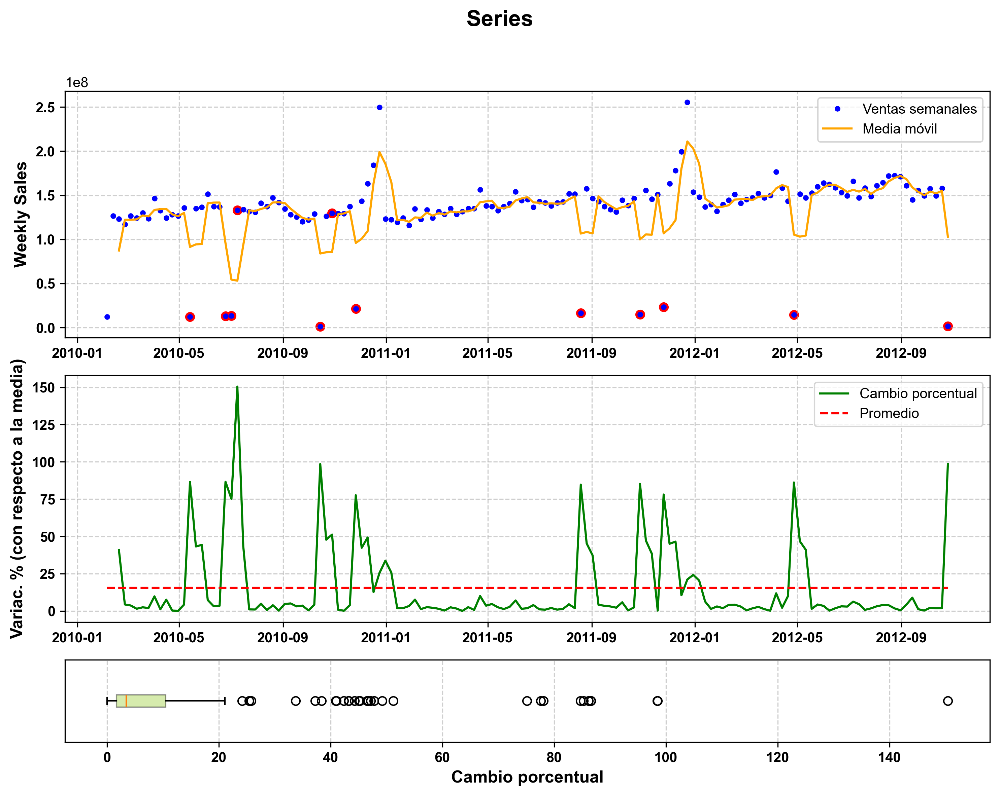

In [164]:
STS(df=df,
    store=39,
    window=3,
    porcentaje=50)

In [165]:
df = df.query('not (Store==39 and Weekly_Sales<0.5e8)')

**Veamos la tienda 40.**

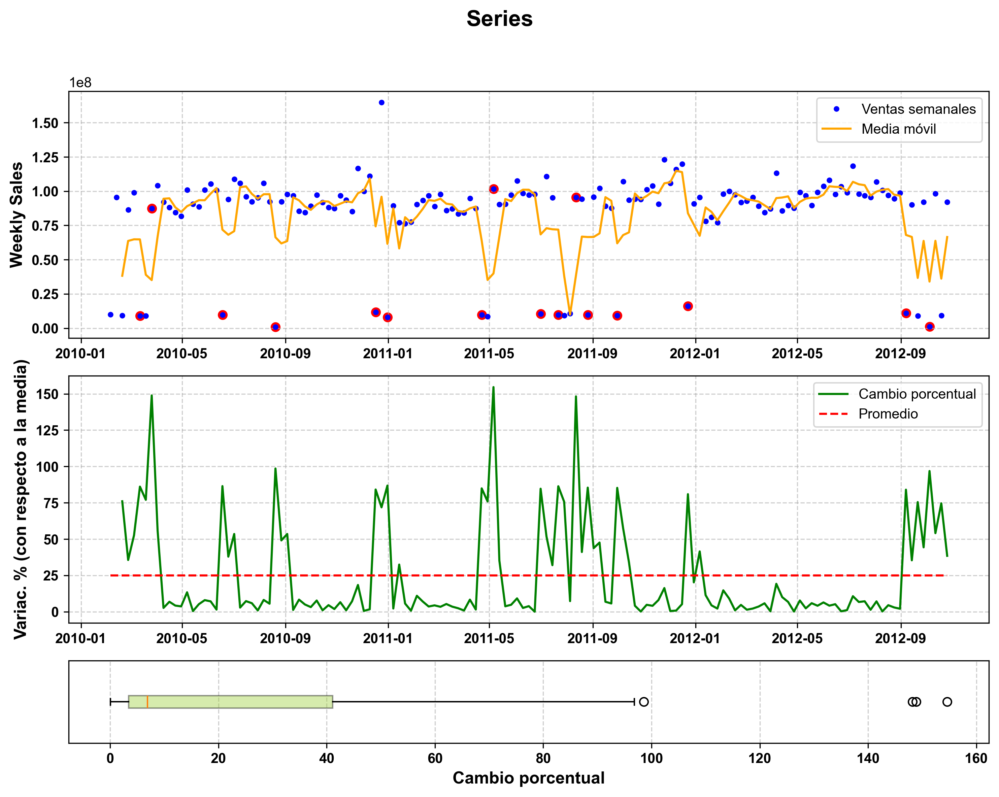

In [168]:
STS(df=df,
    store=40,
    window=3,
    porcentaje=80)

In [169]:
df = df.query('not (Store==40 and Weekly_Sales<0.25e8)')

**Veamos la tienda 41.**

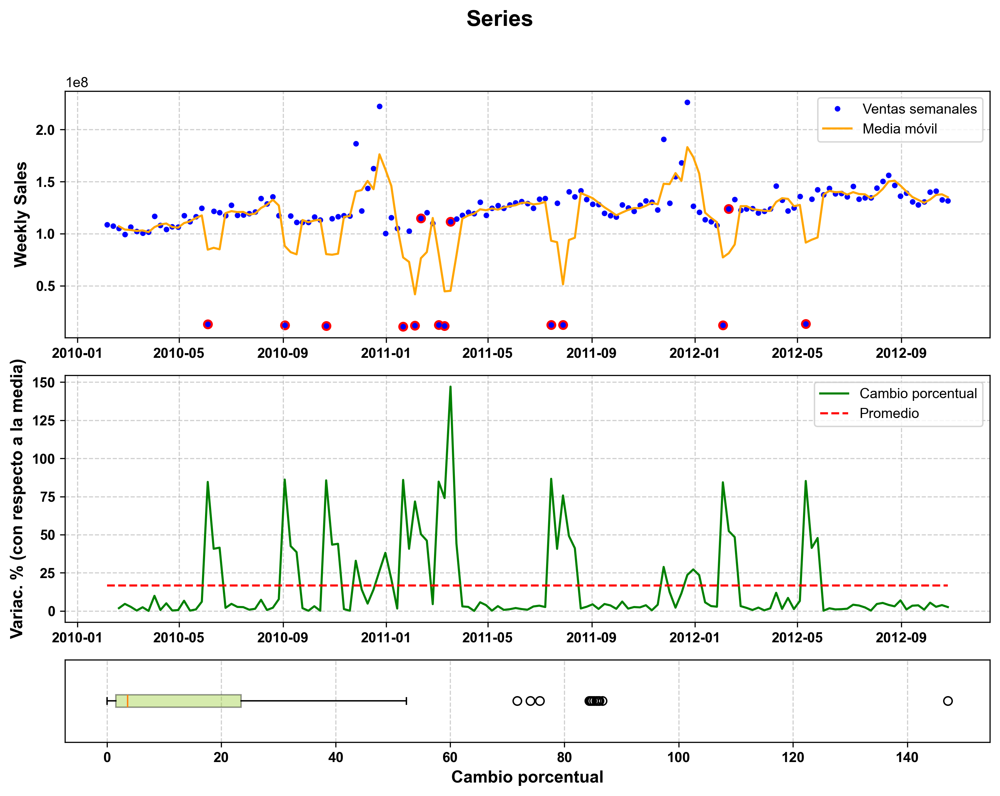

In [172]:
STS(df=df,
    store=41,
    window=3,
    porcentaje=50)

In [173]:
df = df.query('not (Store==41 and Weekly_Sales<0.5e8)')

**Veamos la tienda 42.**

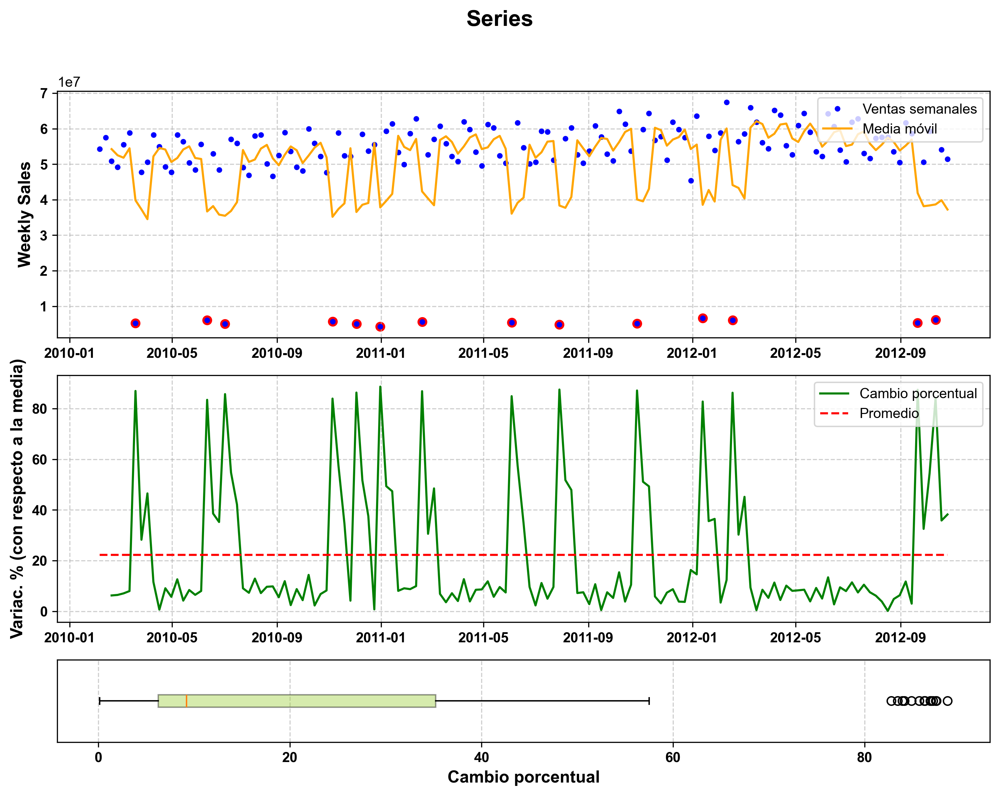

In [176]:
STS(df=df,
    store=42,
    window=3,
    porcentaje=70)

In [177]:
df = df.query('not (Store==42 and Weekly_Sales<1e7)')

**Veamos tienda 43.**

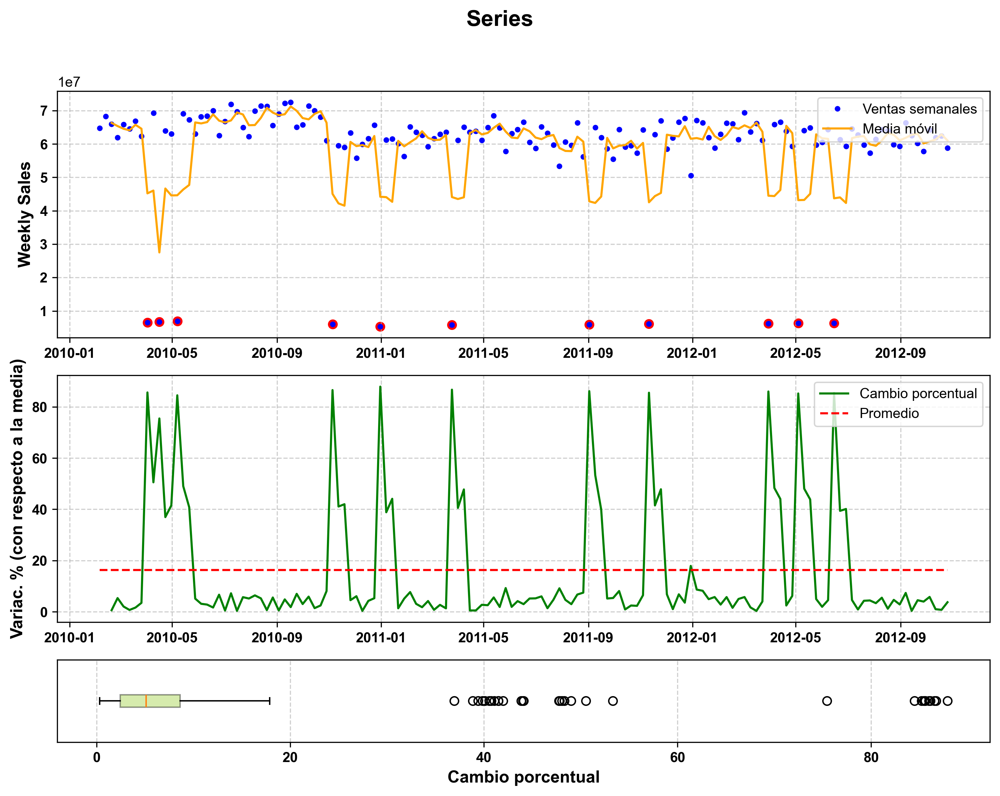

In [179]:
STS(df=df,
    store=43,
    window=3,
    porcentaje=70)

In [ ]:
df = df.query('not (Store==43 and Weekly_Sales<1e7)')

**Veamos la tienda 44.**

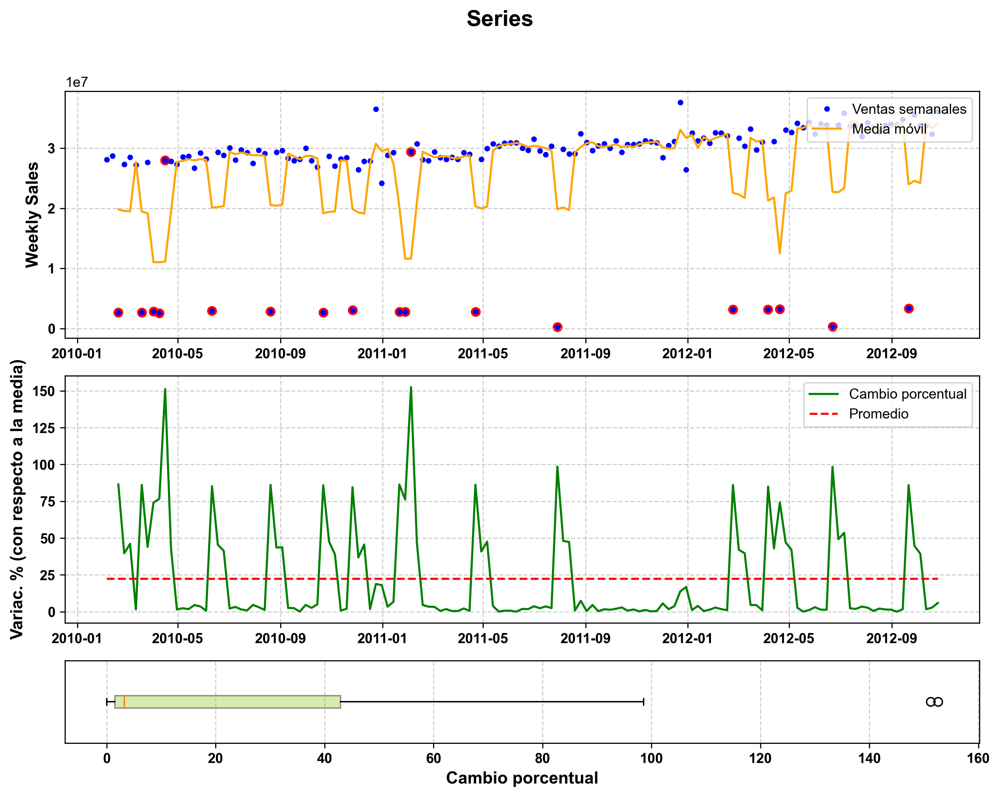

In [182]:
STS(df=df,
    store=44,
    window=3,
    porcentaje=70)

In [183]:
df = df.query('not (Store==44 and Weekly_Sales<1e7)')

**Veamos la tienda 45.**

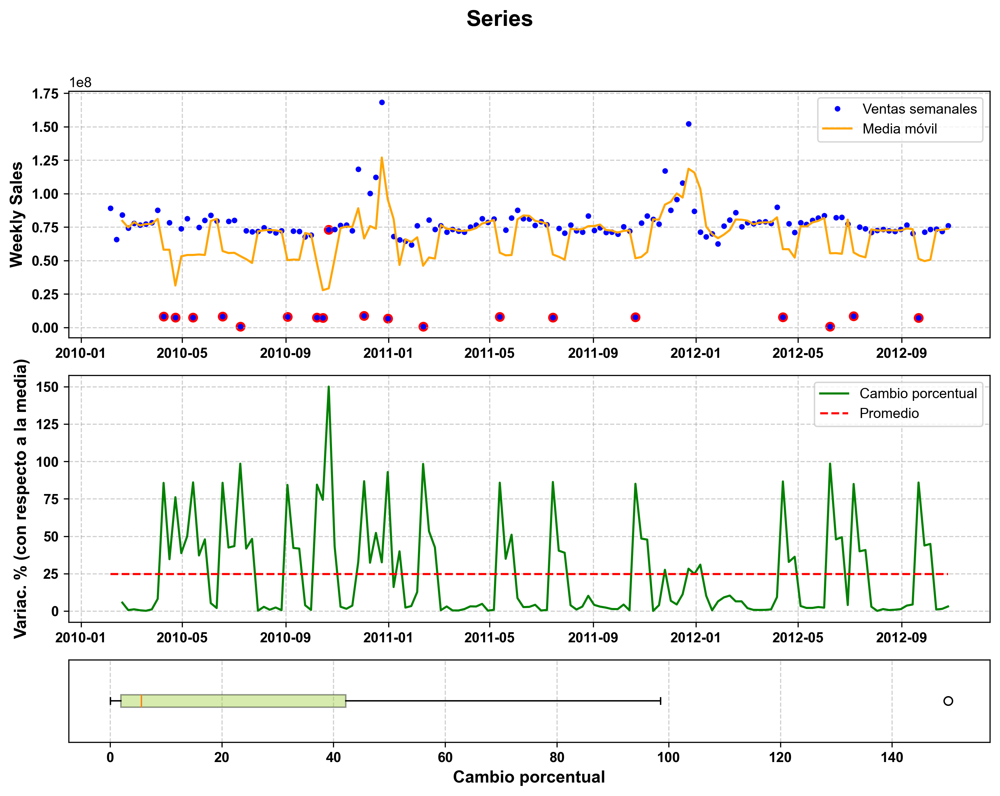

In [185]:
STS(df=df,
    store=45,
    window=3,
    porcentaje=70)

In [186]:
df = df.query('not (Store==45 and Weekly_Sales<0.25e8)')

# Series limpias

Recordemos que las series de datos de ventas se depuraron considerando los valores atípicos identificados a través del incremento porcentual. Sin embargo, no todos los valores marcados como atípicos por esta métrica fueron eliminados. El incremento porcentual se utilizó principalmente como una herramienta para confirmar qué valores eran realmente anómalos. Solo se descartaron aquellos que generaban un ruido significativo en la serie. A continuación, observemos el resultado de esta limpieza en algunas series.

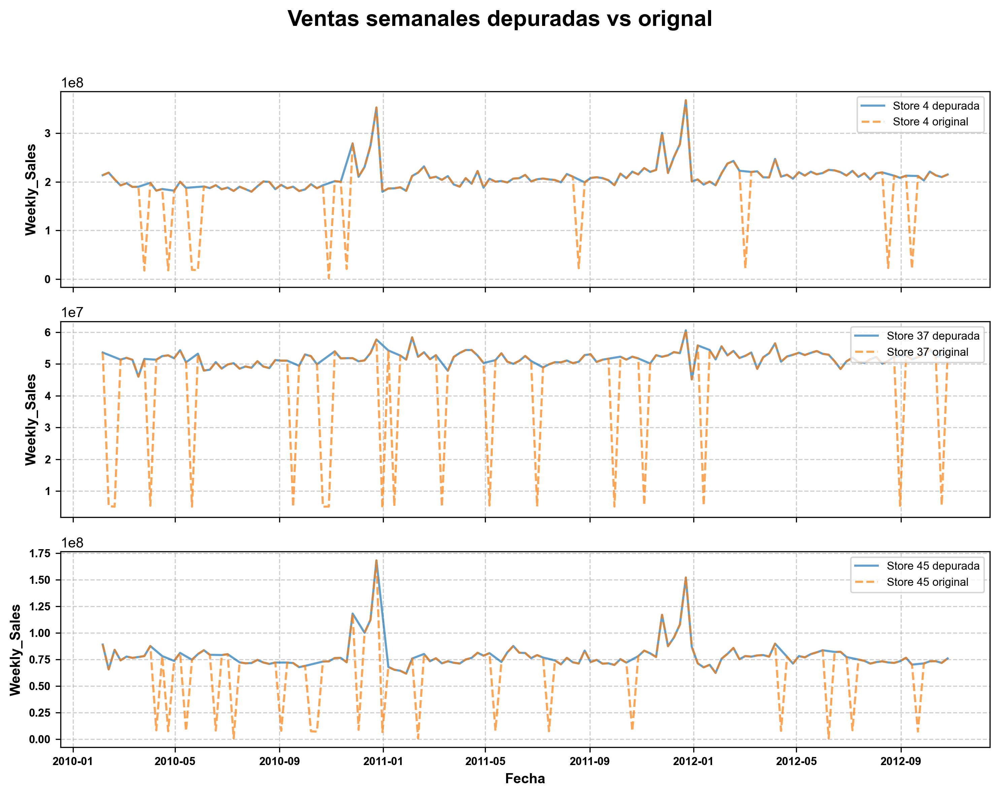

In [200]:
fig, axs = plt.subplots(3, figsize=(10, 8), sharex=True,dpi=300)
fig.suptitle('Ventas semanales depuradas vs orignal', fontsize=16, fontweight='bold')
stores = [4, 37, 45]
for i, store in enumerate(stores):
    data = df[df['Store'] == store]
    data2 = WalmartSales[WalmartSales['Store']==store]
    axs[i].plot(data['Weekly_Sales'], '-', label=f'Store {store} depurada', alpha=0.7)
    axs[i].plot(data2['Weekly_Sales'], '--', label=f'Store {store} original', alpha=0.7)
    # Configurar el eje Y
    axs[i].set_ylabel('Weekly_Sales', fontsize=10, fontweight='bold')
    axs[i].legend(loc='upper right', fontsize=8)
    axs[i].grid(visible=True, linestyle='--', alpha=0.6)
    axs[i].tick_params(axis='y', labelsize=8)
    for tick in axs[i].get_yticklabels():
        tick.set_fontweight('bold')

# Configurar el eje X solo para el último subplot
axs[-1].set_xlabel('Fecha', fontsize=10, fontweight='bold')
axs[-1].tick_params(axis='x', labelsize=8)
for tick in axs[-1].get_xticklabels():
    tick.set_fontweight('bold')

plt.tight_layout(rect=[0, 0, 1, 0.96])  
plt.show()

Podemos observar que la serie depurada, representada en color azul, mantiene un comportamiento estacional claro. En cambio, la línea punteada muestra la serie original, en la cual se aprecian varios valores con cambios abruptos. Estos picos pueden generar problemas en los modelos que se entrenen, ya que es probable que afecten la normalidad de los residuos. Los valores atípicos presentes podrían interferir con la capacidad del modelo para capturar información relevante de manera precisa.

# Porcentaje eliminado

Veamos cuántos valores se eliminaron en total.

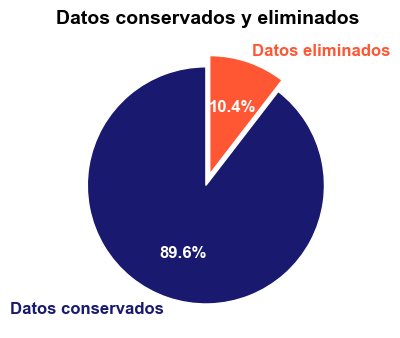

In [220]:
filas_eliminadas = len(WalmartSales) - len(df)
porcentaje_eliminado = (filas_eliminadas / len(WalmartSales)) * 100
porcentaje_total = 100 - porcentaje_eliminado

porcentajes = [porcentaje_total, porcentaje_eliminado]
categorias = ['Datos conservados', 'Datos eliminados']
colores = ['#191970', '#FF5733']  

# Crear el gráfico circular
fig, ax = plt.subplots(figsize=(4, 4))
wedges, texts, autotexts = ax.pie(porcentajes, labels=categorias, autopct='%1.1f%%', startangle=90, colors=colores,
                                  wedgeprops={'edgecolor': 'white'}, textprops={'fontsize': 12,'color':'white','fontweight': 'bold'},
                                  explode=[0.05, 0.05])
texts[0].set_color('#191970')  # Cambiar color de "Datos conservados"
texts[1].set_color('#FF5733')
ax.set_title('Datos conservados y eliminados', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

Podemos observar que se eliminó un 10.4% de los datos, lo cual es una cantidad considerable. Esto plantea la necesidad de reflexionar sobre el impacto de estos valores atípicos. Sin embargo, no los analizaremos en detalle. En su lugar, utilizaremos el 89.6% restante de los datos para llevar a cabo el análisis exploratorio y el entrenamiento de los modelos.

In [221]:
# Guardando dataframe. La ruta donde queda guardado es la incluida es os.chdir()
df.to_csv('WalmartSalesClean.csv', index=True)

# Conclusiones

**A continuación, se presentan las conclusiones generales mejoradas:**

- **Valores atípicos:** En todas las series de tiempo analizadas, se identificaron valores atípicos en los siguientes rangos: 1e8, 1e7, 0.5e8, 0.5e7, 0.25e7 y 0.25e8. Estos valores se destacaron significativamente del comportamiento general de la serie, lo que indica que podrían representar anomalías o errores que deben ser gestionados adecuadamente.

- **Incremento porcentual:** Aunque el incremento porcentual detectó valores atípicos en diversos rangos, solo se eliminaron aquellos que se encontraban dentro de los rangos mencionados previamente. Esta decisión se tomó con el fin de evitar la eliminación de datos valiosos y minimizar la reducción drástica del conjunto de datos, preservando así la integridad de la información disponible para el análisis.

- **Porcentaje de datos eliminados:** Se eliminó un 10.4% de los datos debido a los valores atípicos identificados. Este porcentaje plantea la necesidad de reflexionar sobre el impacto potencial de dichos valores atípicos en los modelos de análisis y su capacidad para generar predicciones precisas. Sería interesante realizar un análisis más profundo de estos valores atípicos para entender su origen y evaluar si deben ser tratados de manera diferente o si pueden proporcionar información valiosa para la toma de decisiones.